This pipeline opens the result of ICAalamelodic.m, lets the user interactively label the components that look like neuronal activity (rather than movement artefacts or noise), sort them by label, plots a final summary for the chosen components, and save the reordered maps and time series.

In [2]:
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from scipy import io
%matplotlib inline 
import pylab

Open time series

In [3]:
import scipy.io as sio

In [4]:
# from http://stackoverflow.com/questions/3579568/choosing-a-file-in-python-with-simple-dialog
from Tkinter import Tk
from tkFileDialog import askopenfilename

Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
filename = askopenfilename() # show an "Open" dialog box and return the path to the selected file
print(filename)

/media/sophie/New Volume/100618series/100618regcdFF2000pointspsfkfconcat156Smith0_4_60TS.mat


In [5]:
Ua=sio.loadmat(filename)

In [6]:
DT=Ua['TSo']

In [7]:
DT.shape

(10948, 156)

In [8]:
S1=DT.shape

In [9]:
DTmean=np.zeros(S1)
DTvar=np.zeros(S1)
Var=np.zeros(S1[1])

In [10]:
for i in range(S1[1]):
    DTmean[:,i]=DT[:,i]-np.mean(DT[:,i],0)

In [11]:
for i in range(S1[1]):
    Var[i]=np.sqrt(np.var(DTmean[:,i]))
    DTvar[:,i]=DTmean[:,i]/Var[i]

In [12]:
DTvar.shape

(10948, 156)

open maps

In [13]:
import nibabel as nb

In [14]:
# from http://stackoverflow.com/questions/3579568/choosing-a-file-in-python-with-simple-dialog
from Tkinter import Tk
from tkFileDialog import askopenfilename

Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
filename2 = askopenfilename() # show an "Open" dialog box and return the path to the selected file
print(filename2)

/media/sophie/New Volume/100618series/100618regcdFF2000pointspsfkfconcat156Smith0_4_60IC.nii


In [15]:
img1 = nb.load(filename2)

In [16]:
data = img1.get_data()

In [17]:
S=data.shape

In [18]:
S

(78, 69, 10, 156)

# Zscore maps

In [19]:
Demean=np.zeros(S)
Dmaps=np.zeros(S)
Dvar=np.zeros(S)
Var=np.zeros(S[3])
D2=np.zeros([S[0],S[1],5,S[3]])
Tvar=np.zeros(S[3])

Transform the maps to have zero mean

In [20]:
for i in range(S[3]):
    Demean[:,:,:,i]=data[:,:,:,i]-np.mean(np.mean(np.mean(data[:,:,:,i],0),0),0)

Transform the maps to have unit variance and zscore

In [21]:
for i in range(S[3]):
    Dsq=np.reshape(Demean[:,:,:,i],S[0]*S[1]*S[2])
    Var[i]=np.sqrt(np.var(Dsq))
    Dvar=Demean[:,:,:,i]/Var[i]
    Dmaps[:,:,:,i]=Dvar-2.5
Dmaps[Dmaps<0]=0

Order ICs by variance

In [22]:
datao=data
Dmapso=Dmaps

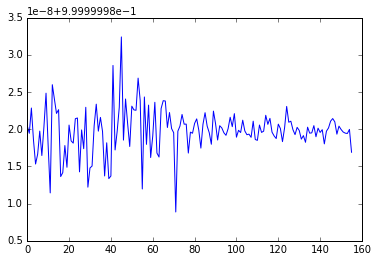

In [23]:
plt.plot(Var)

#Separate maps in substacks, sort the independent components by brain regions 

In [24]:
my_cmap=plt.cm.jet
my_cmap.set_bad(alpha=0)
Good_ICs=np.zeros(S[3])
Label_ICs=[]
pylab.rcParams['figure.figsize'] = (13, 2.5)

In [25]:
Dtemp=data[:,:,:,0]

In [26]:
%%javascript
IPython.OutputArea.auto_scroll_threshold =4000;

<IPython.core.display.Javascript object>

In [27]:
if S[2]>5:
    Nstack=5
    Int100=[(i+1)*100/Nstack for i in range(Nstack)]
    Percs=np.percentile(range(S[2]),Int100)
    Indices=np.split(range(S[2]),Percs)
    D1=np.zeros([S[0],S[1],Nstack])
    Dmean=Dtemp[:,:,range(Nstack)]
    for i in range(Nstack):
        Vmean=np.mean(Dtemp[:,:,Indices[i]],2)
        #Dmean[:,:,i]=np.max(Vmean,0)
        Dmean[:,:,i]=Vmean
else:
    Nstack=S[2]
    D1=np.zeros([S[0],S[1],S[2]])
    Dmean=data[:,:,range(S[2])]  
    Dmean=np.squeeze(Dtemp[:,:,:])

/usr/local/lib/python2.7/dist-packages/numpy/lib/shape_base.py:422: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  sub_arys.append(_nx.swapaxes(sary[st:end], axis, 0))


In [28]:
DTvar.shape

(10948, 156)

In [29]:
S

(78, 69, 10, 156)

In [30]:
# from http://stackoverflow.com/questions/3579568/choosing-a-file-in-python-with-simple-dialog
Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
filename = askopenfilename() # show an "Open" dialog box and return the path to the selected file
print(filename)

/media/sophie/New Volume/100618series/100618/100618X.mat


In [31]:
Ua=sio.loadmat(filename)
Xk=Ua['X']

In [32]:
Xk.shape

(4, 5204)

In [33]:
DTvarnew=DTvar[range(1,5204),:]

In [34]:
DTvarnew.shape

(5203, 156)

0


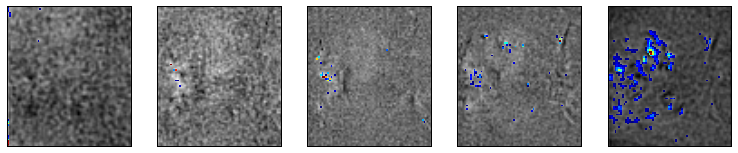

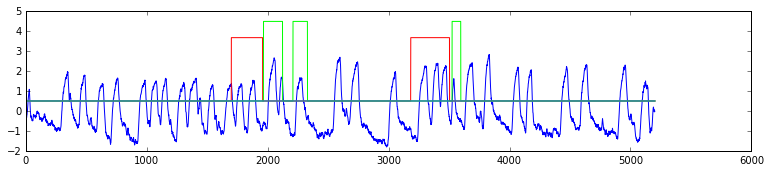


1


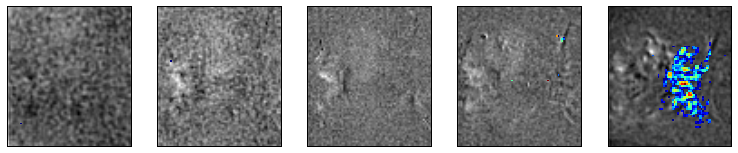

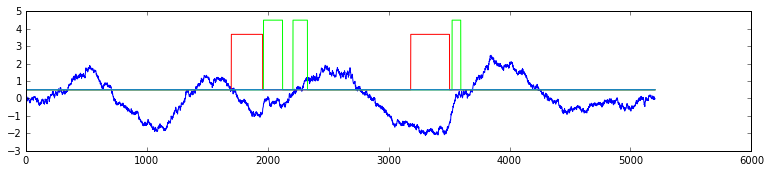


2


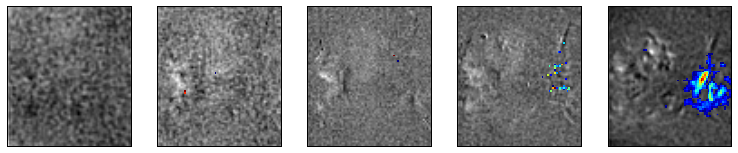

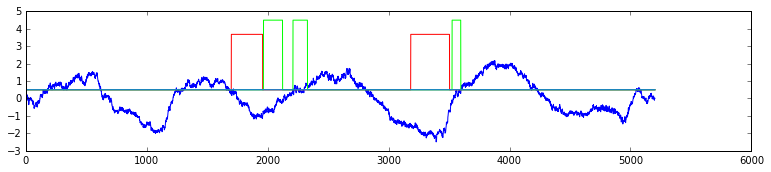


3


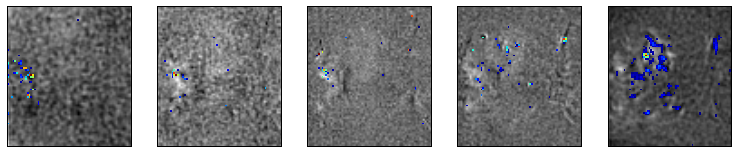

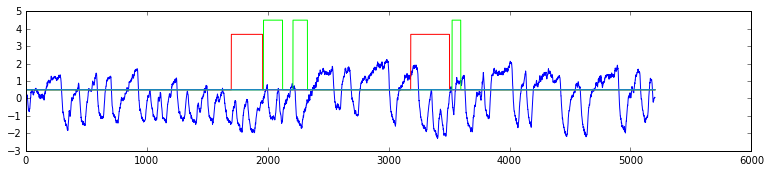


4


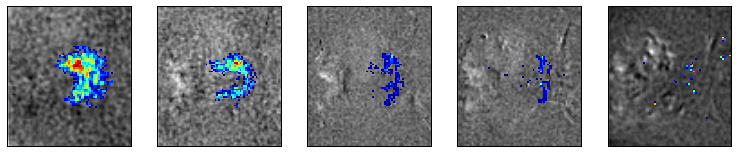

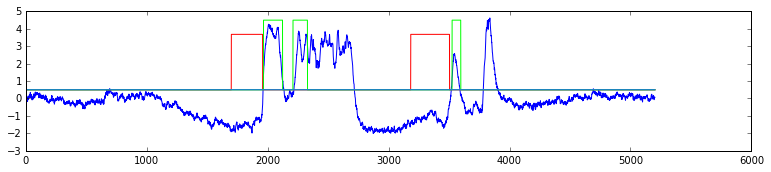

SOG
5


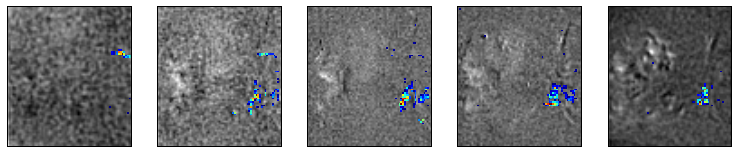

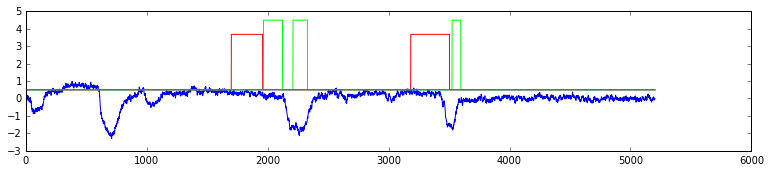


6


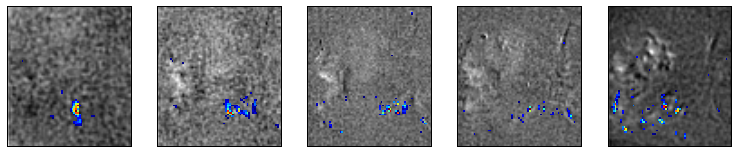

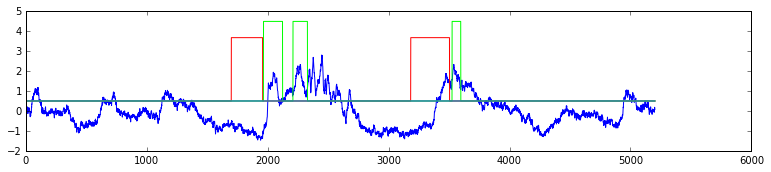


7


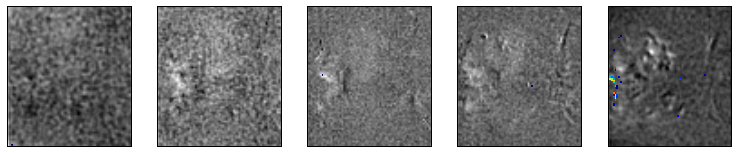

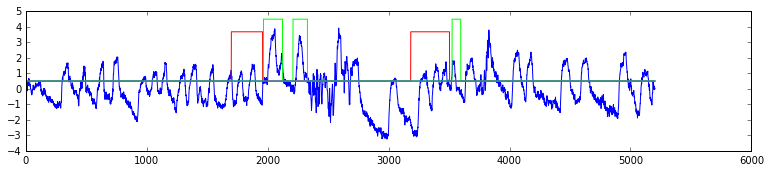


8


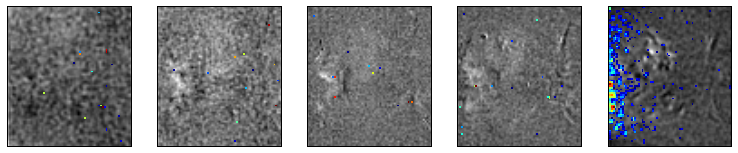

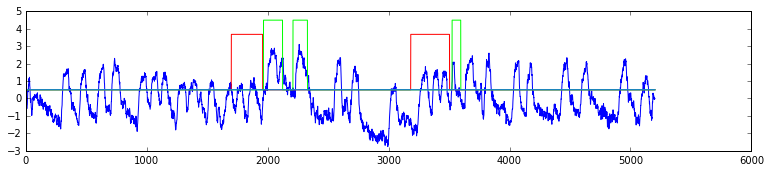


9


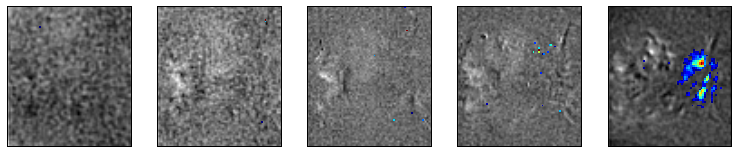

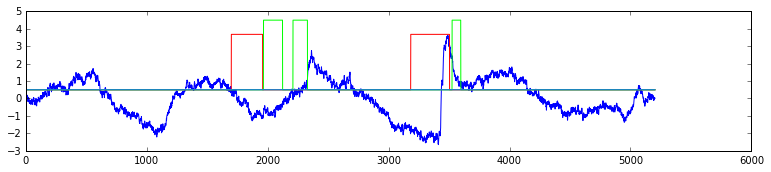


10


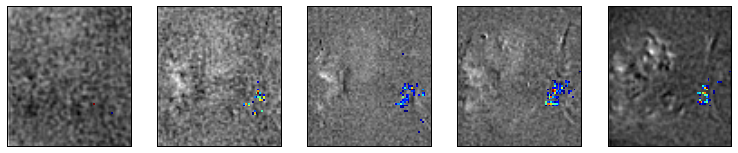

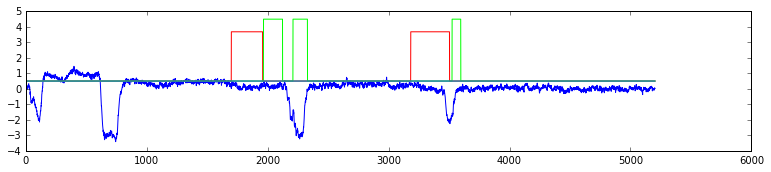


11


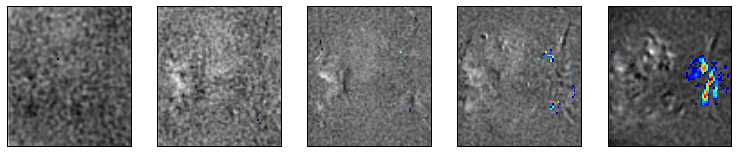

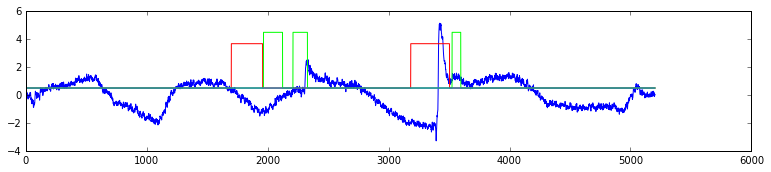


12


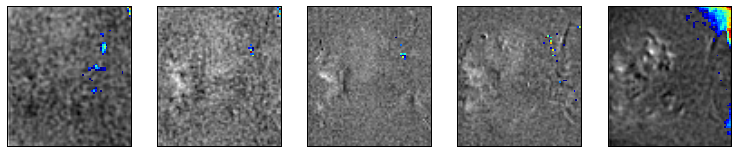

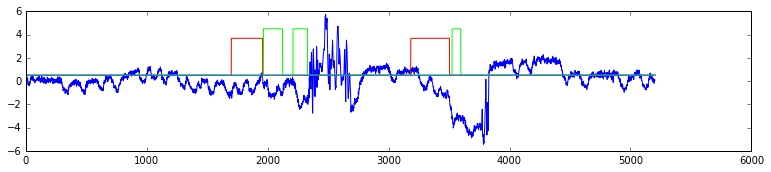


13


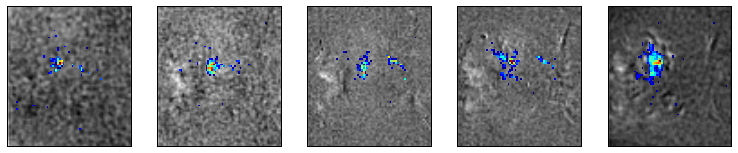

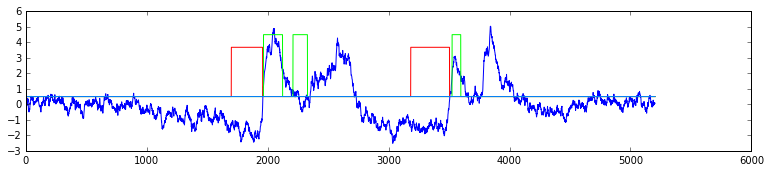

Lat
14


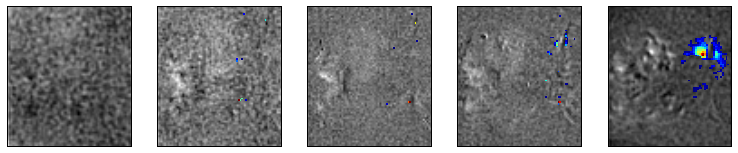

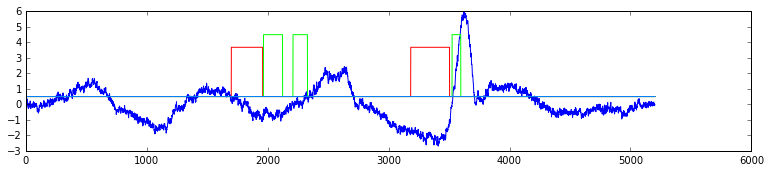


15


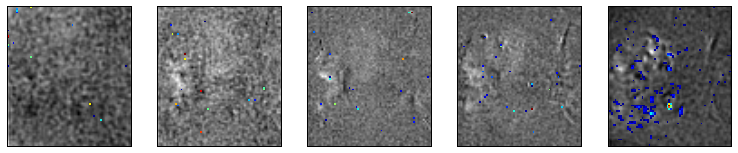

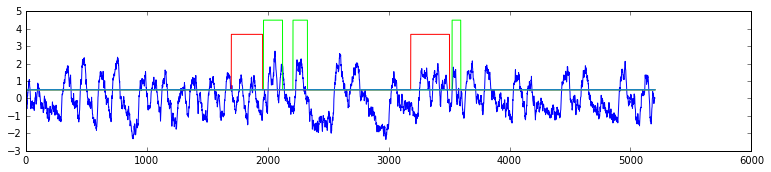


16


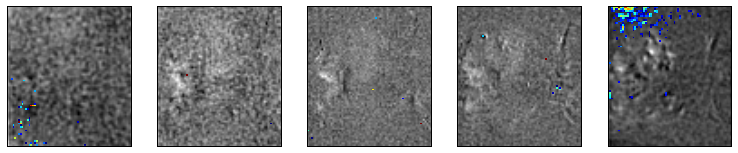

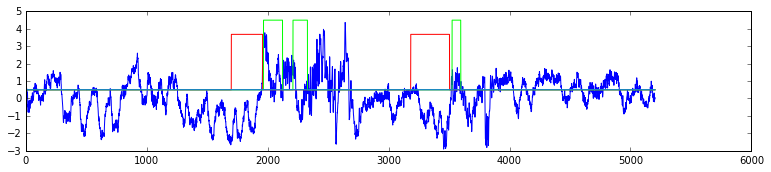


17


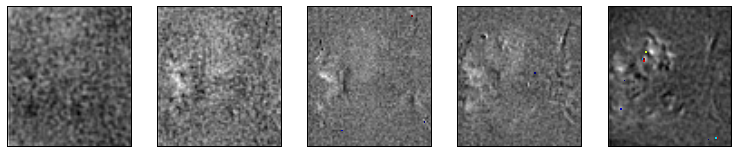

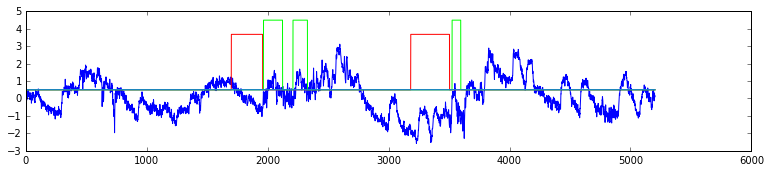


18


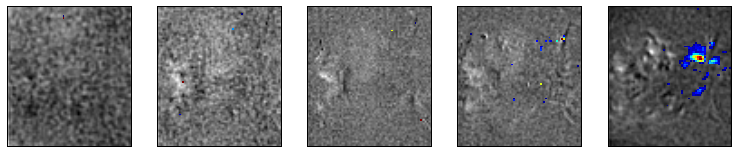

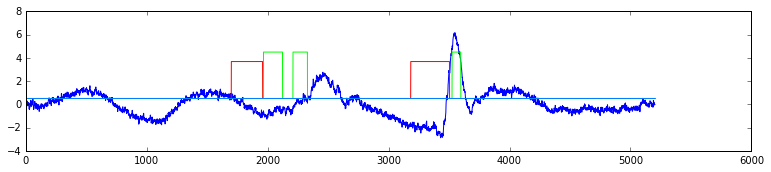


19


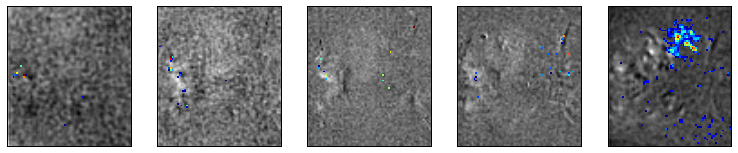

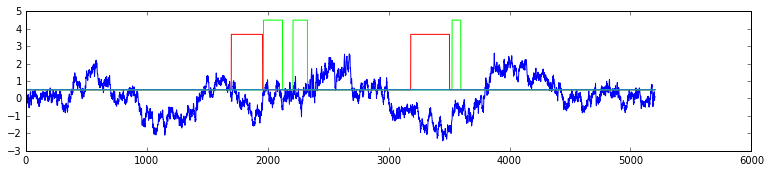


20


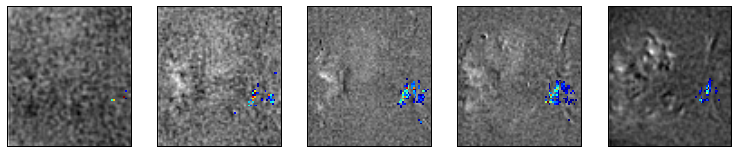

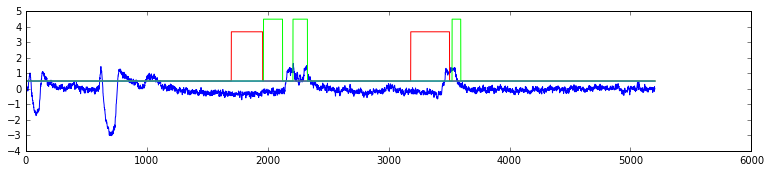


21


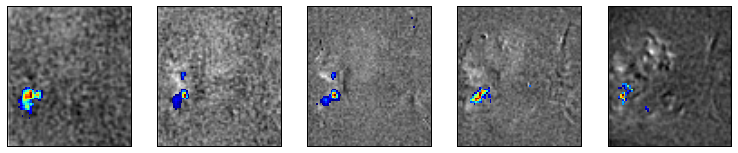

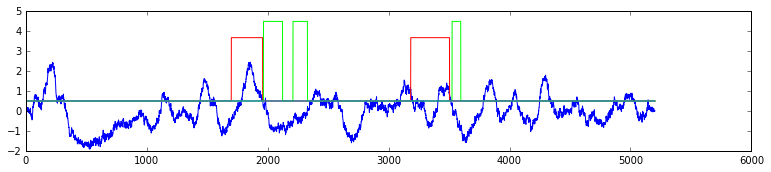

MB
22


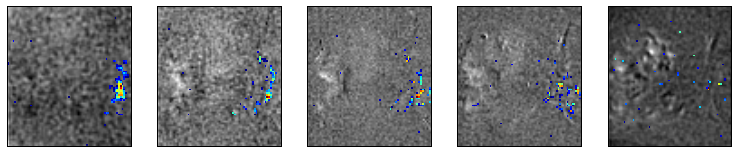

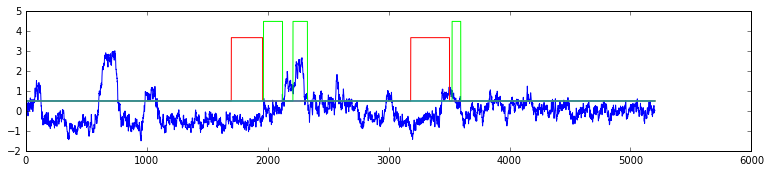


23


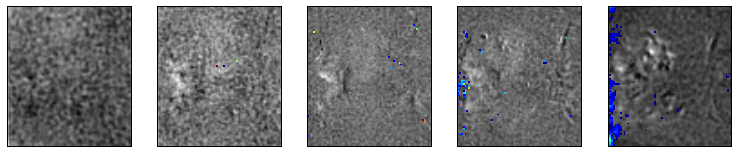

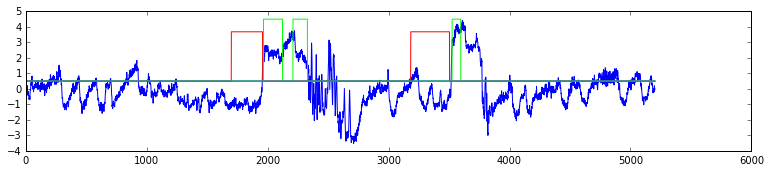


24


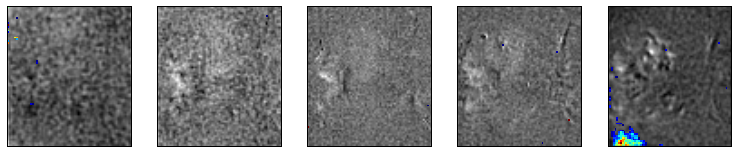

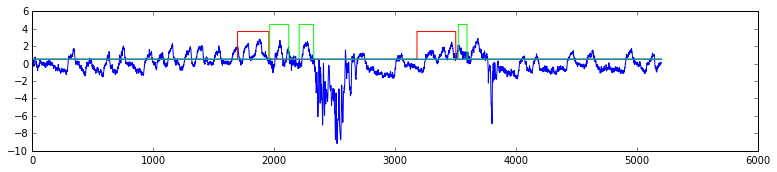


25


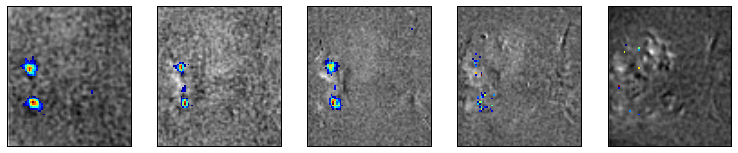

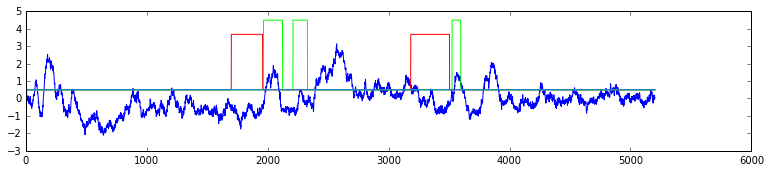

MB
26


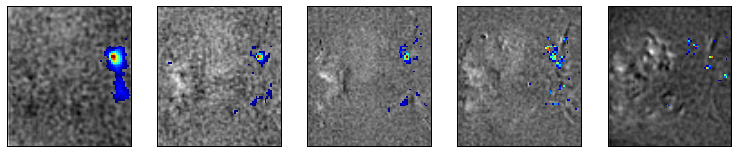

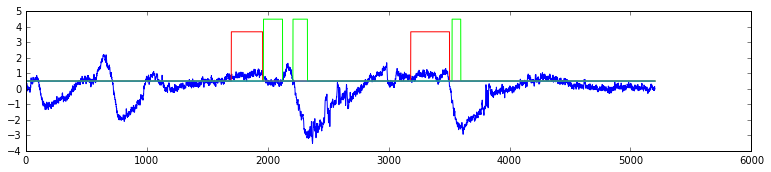


27


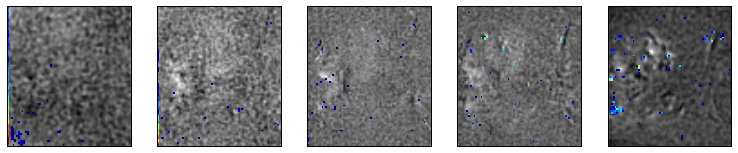

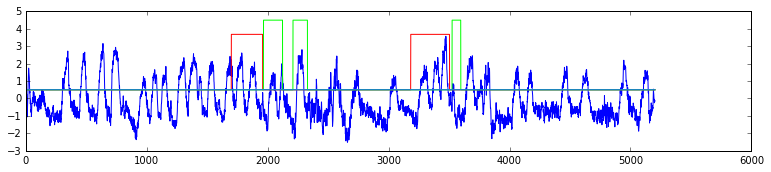


28


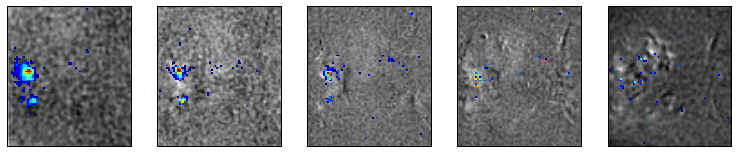

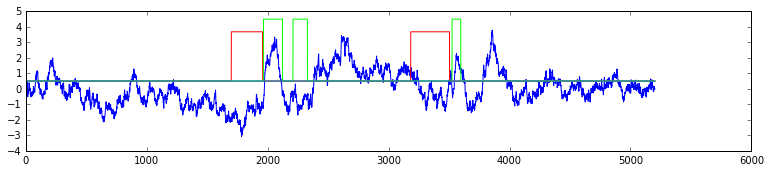

MB
29


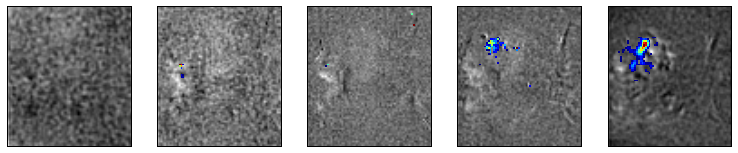

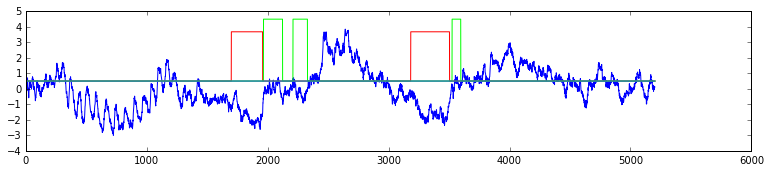

Dorsal
30


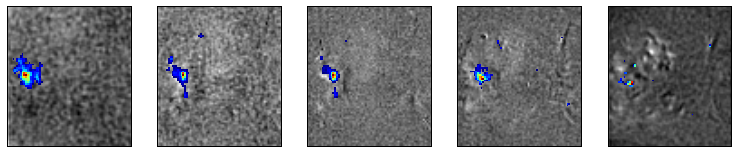

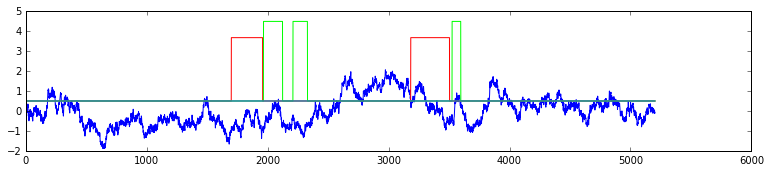

MB
31


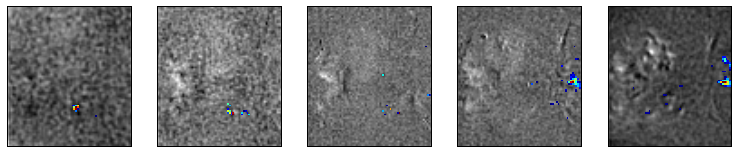

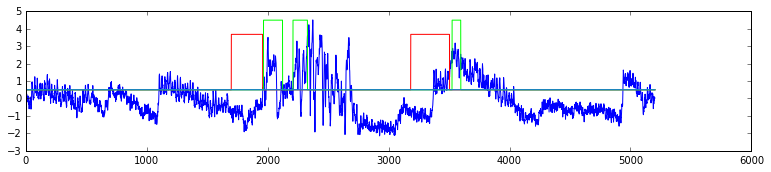


32


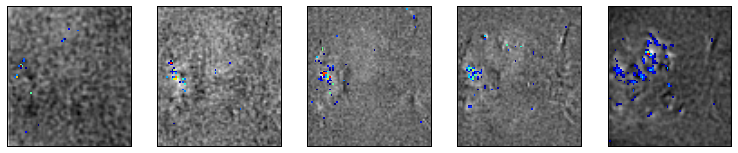

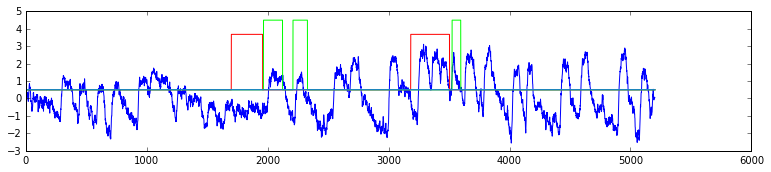


33


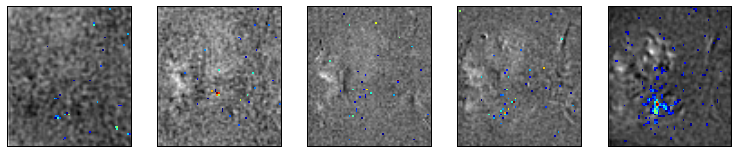

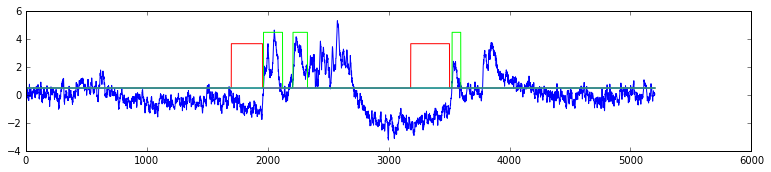


34


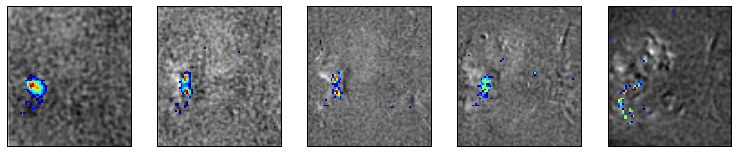

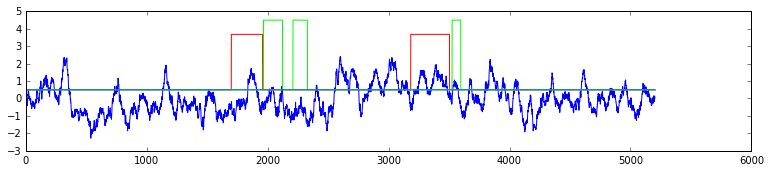

MB
35


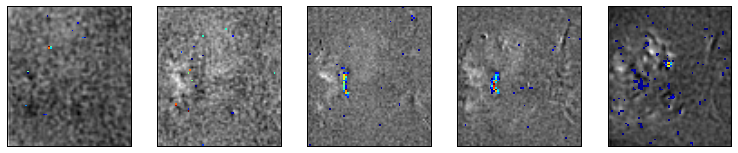

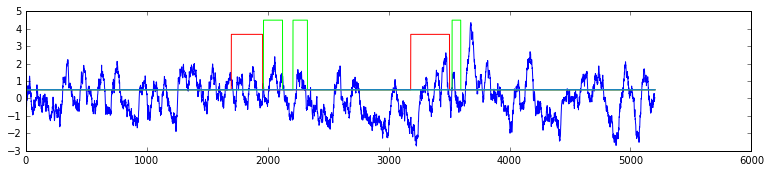

FB
36


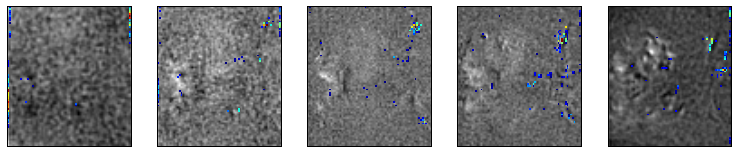

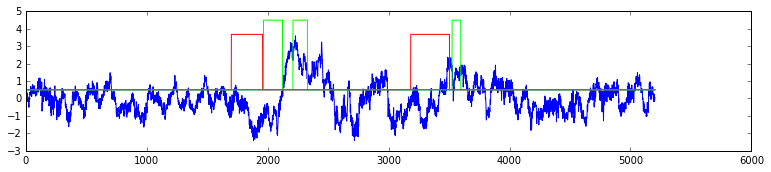


37


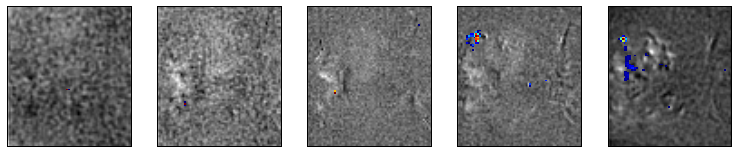

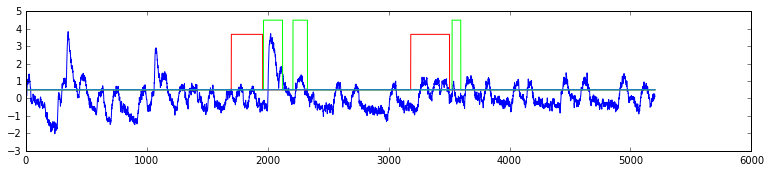

DCB
38


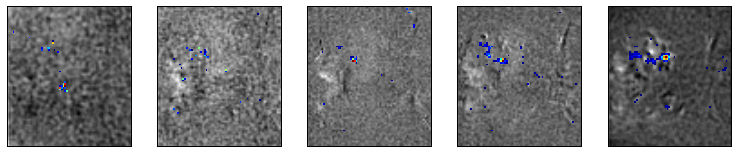

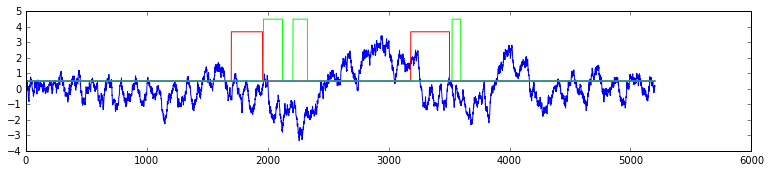


39


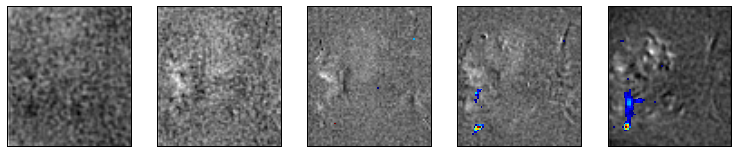

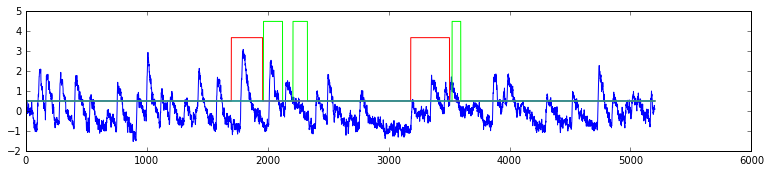

DCB
40


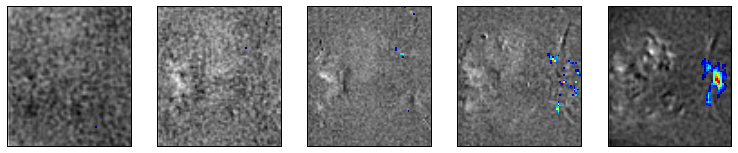

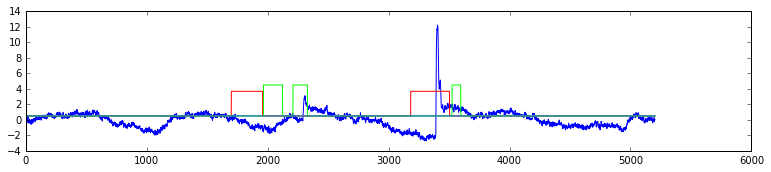


41


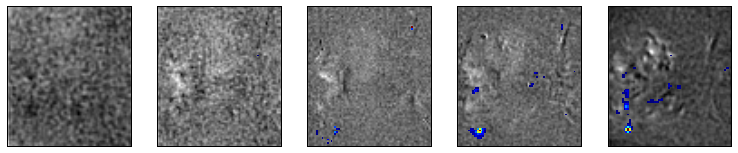

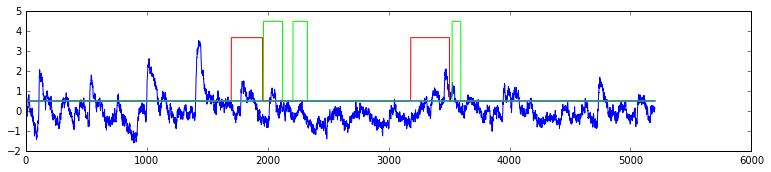


42


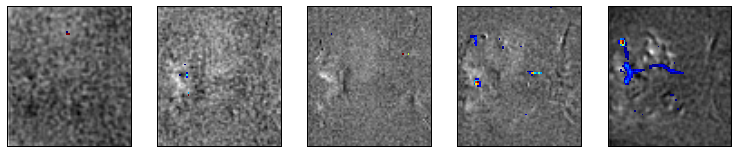

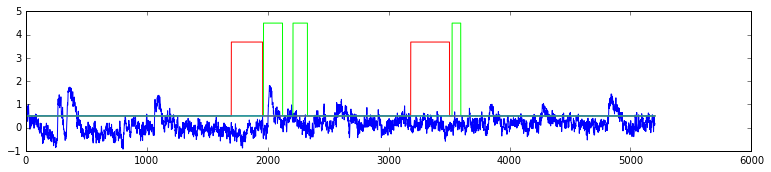

DCB
43


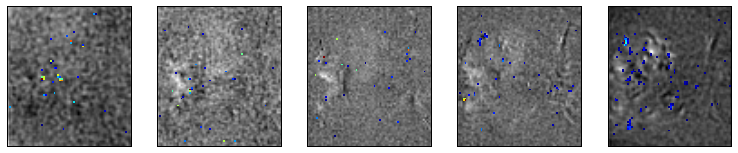

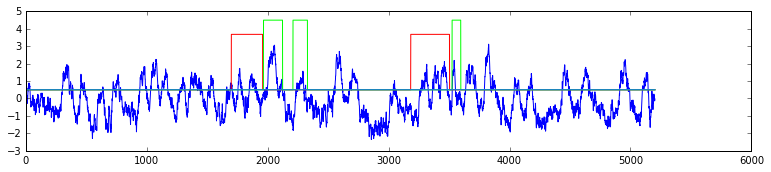


44


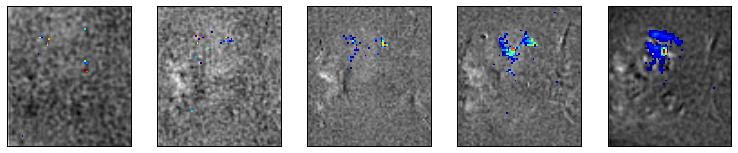

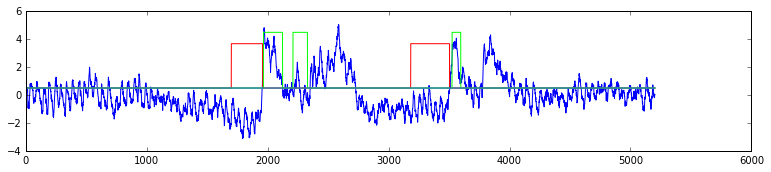

Lat
45


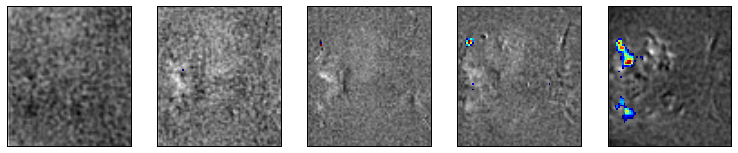

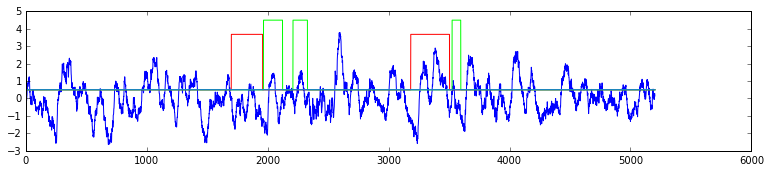


46


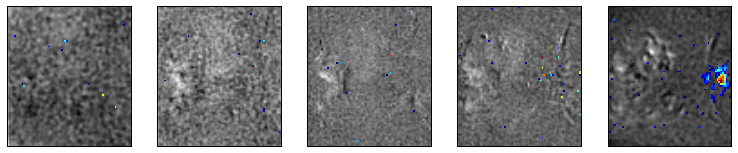

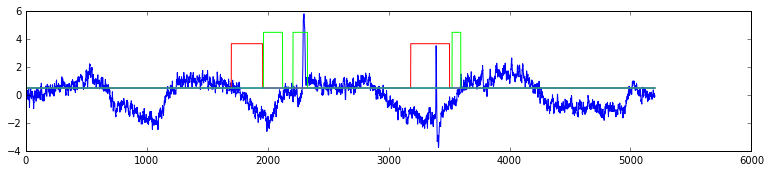


47


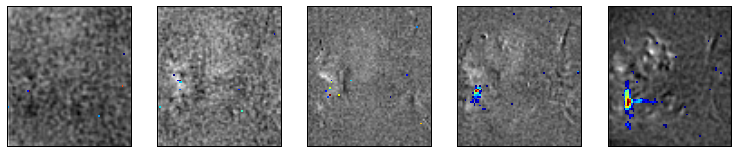

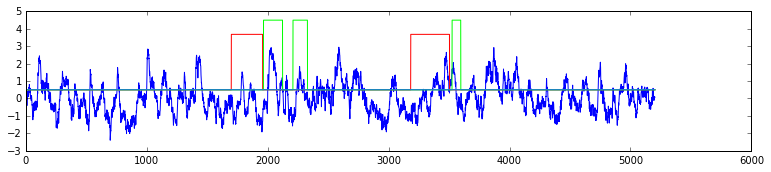

DCB
48


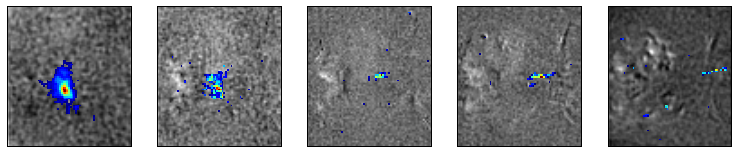

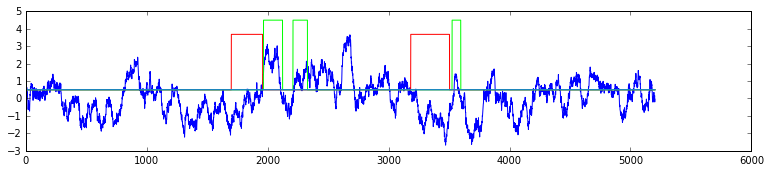

SOG
49


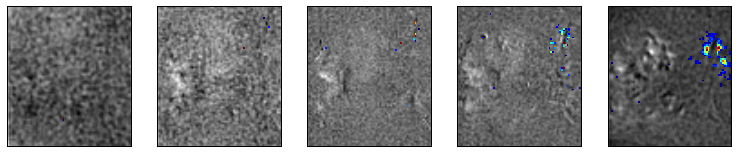

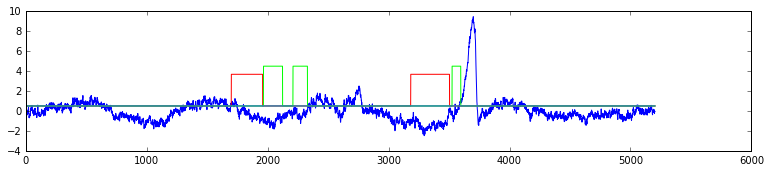


50


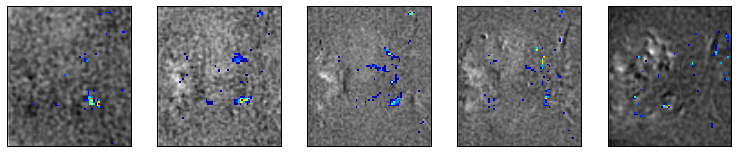

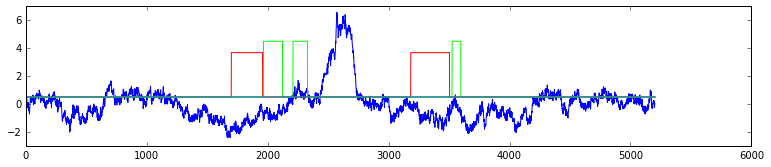


51


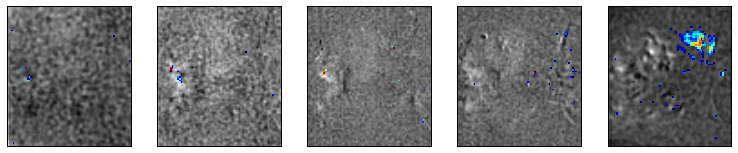

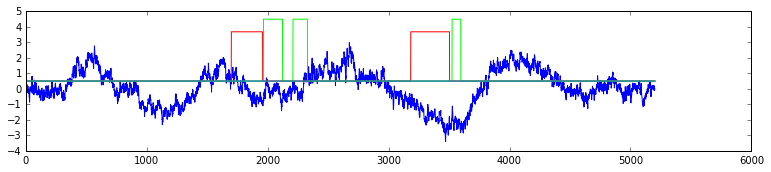


52


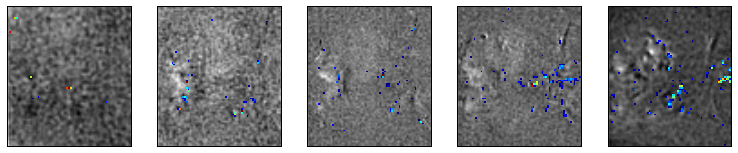

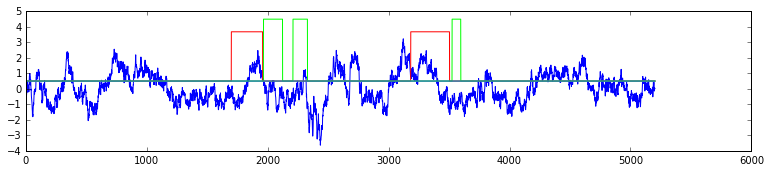


53


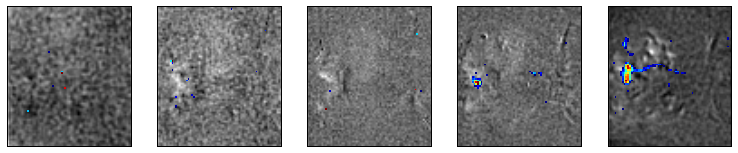

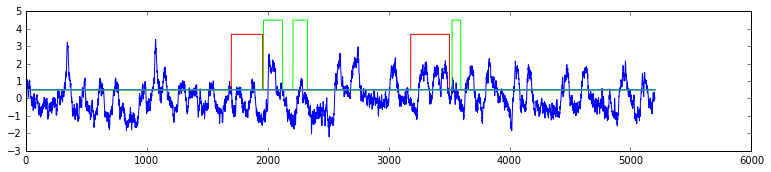

DCB
54


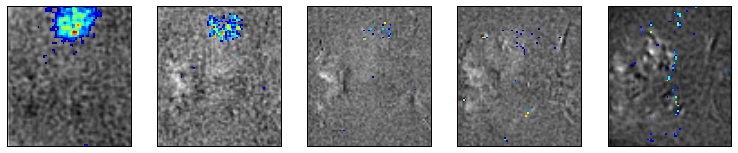

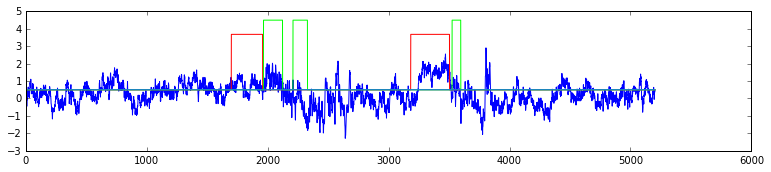


55


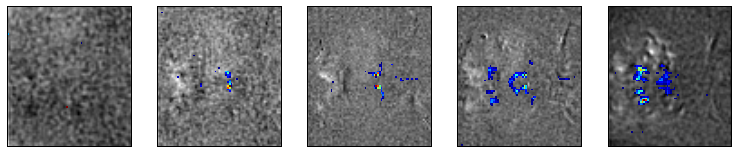

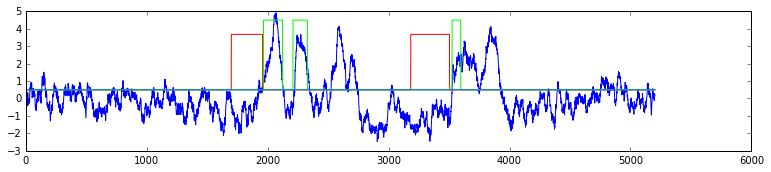

Fla
56


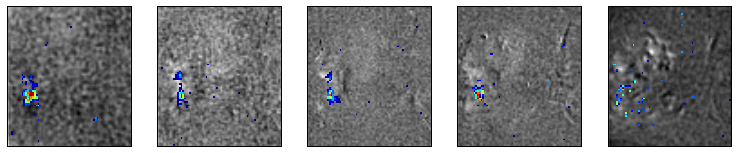

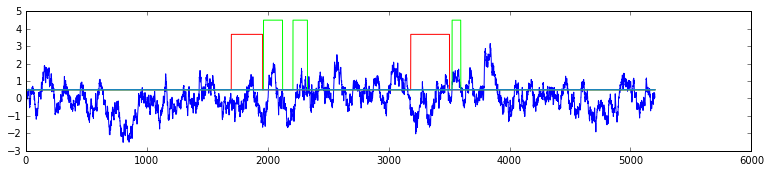

MB
57


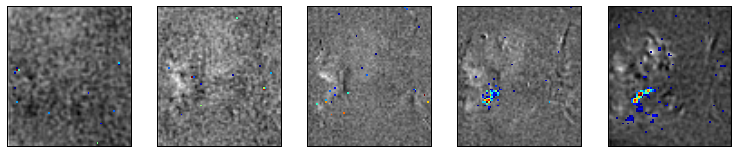

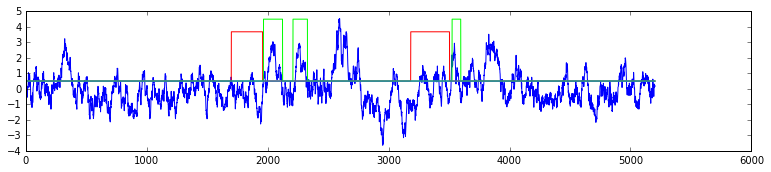

Ant
58


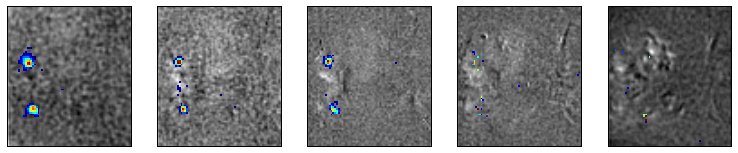

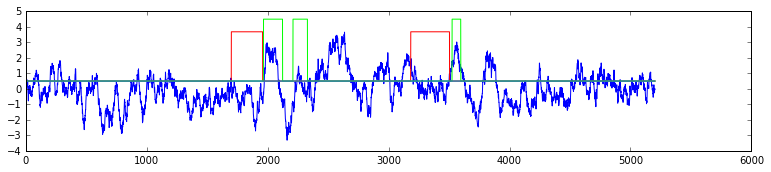

MB
59


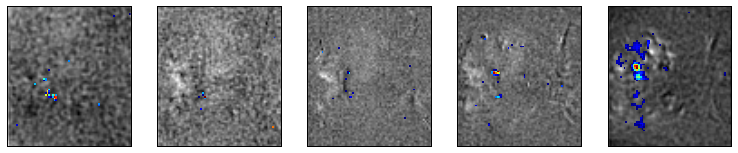

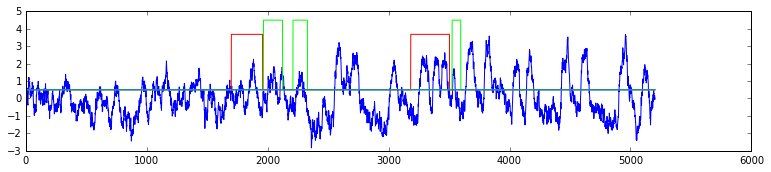

AL
60


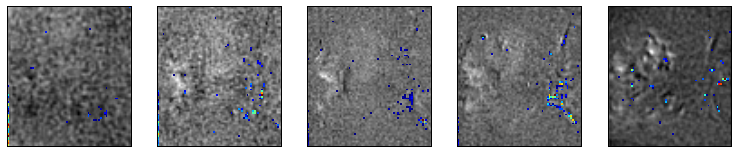

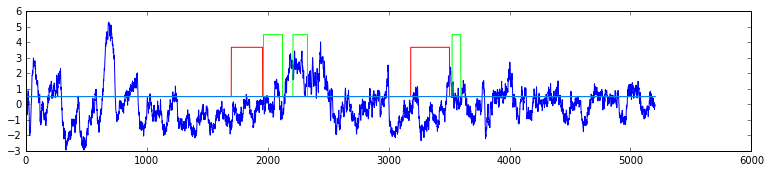


61


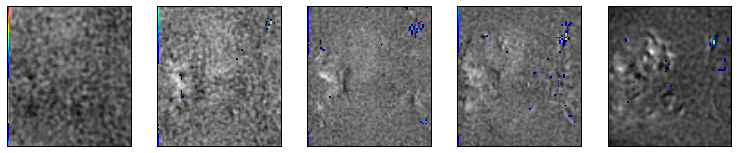

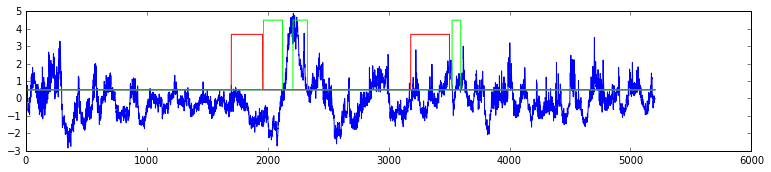


62


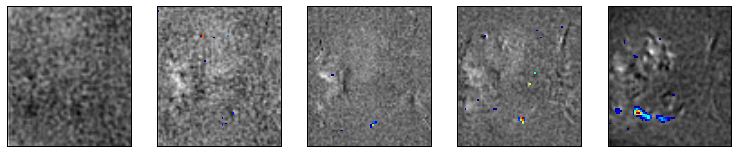

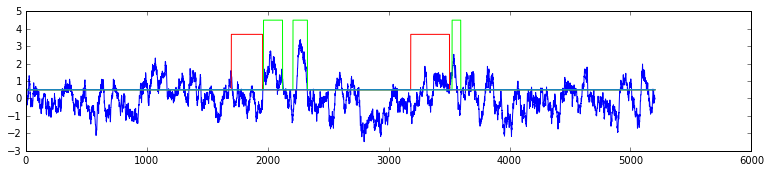

DOrsal
63


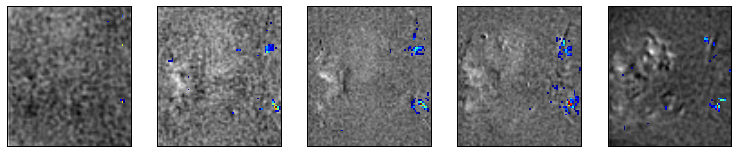

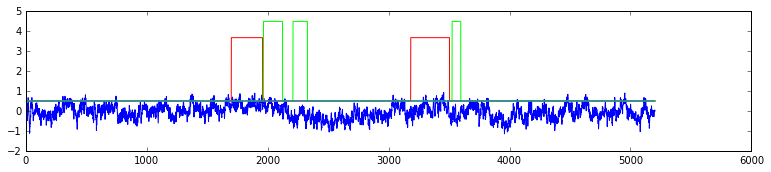


64


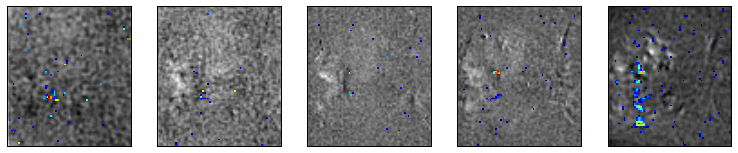

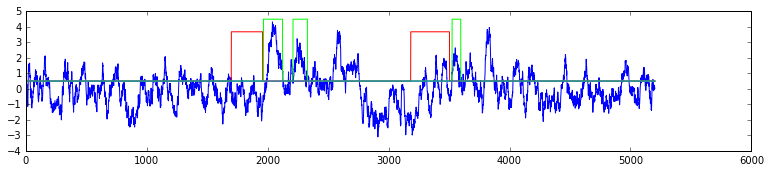


65


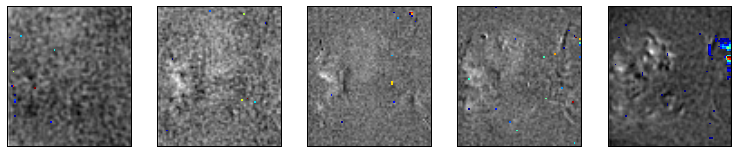

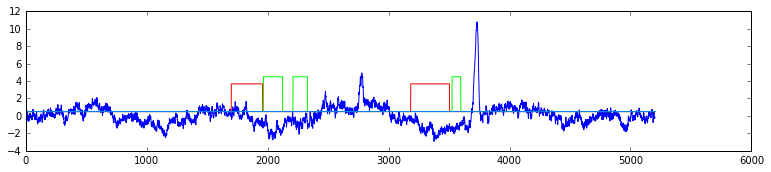


66


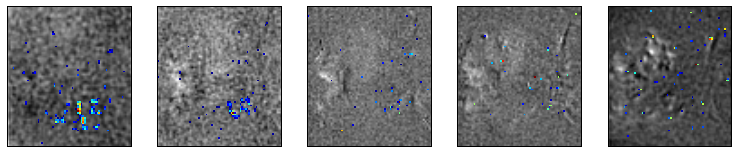

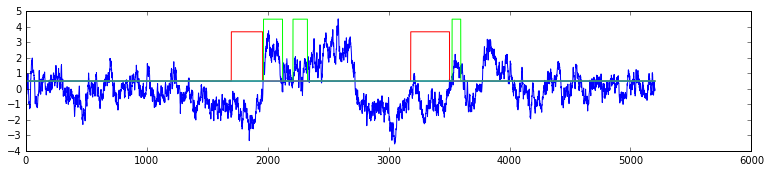


67


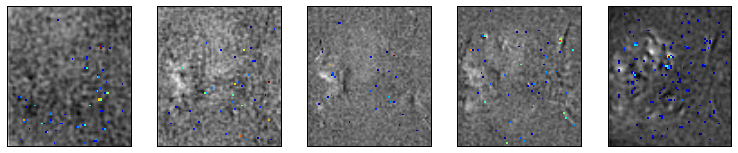

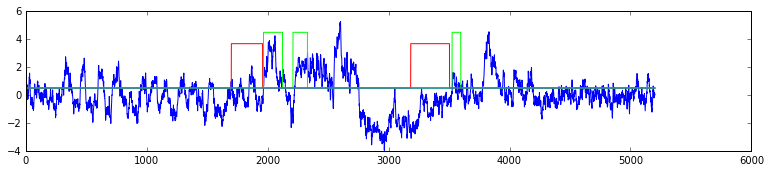


68


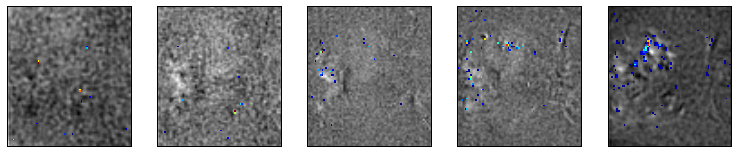

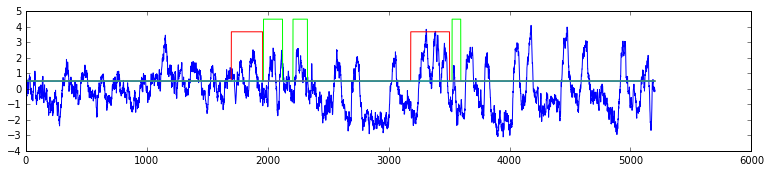


69


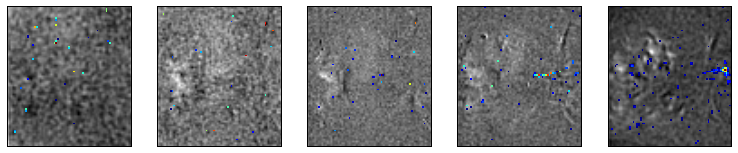

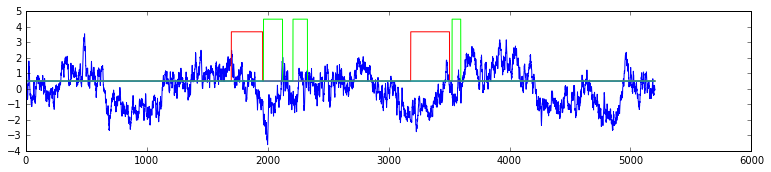


70


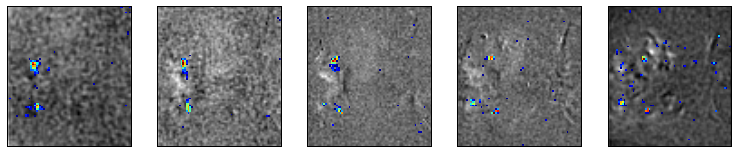

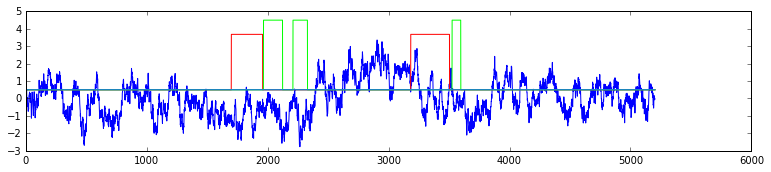

MB
71


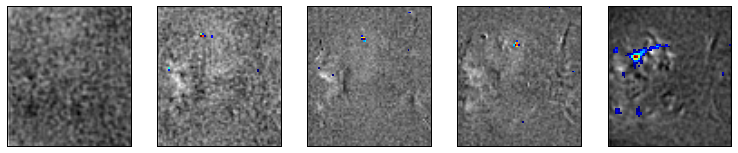

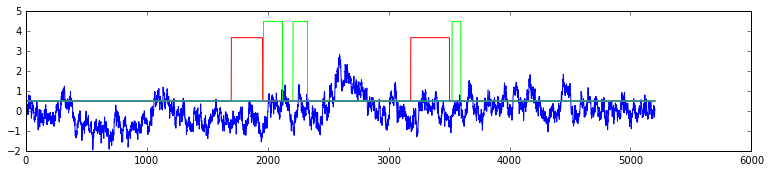

Dorsal
72


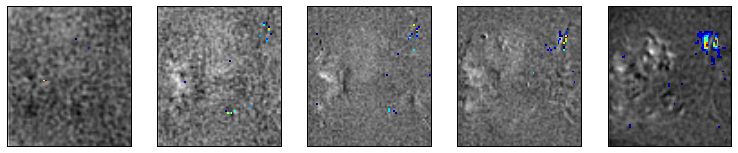

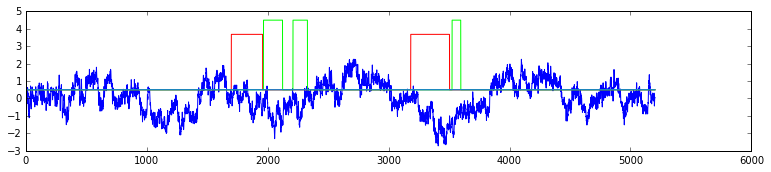


73


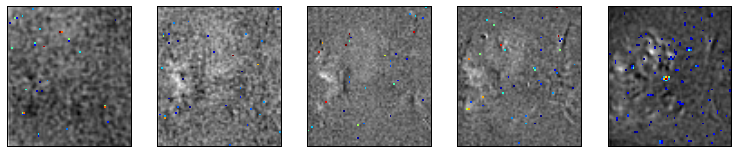

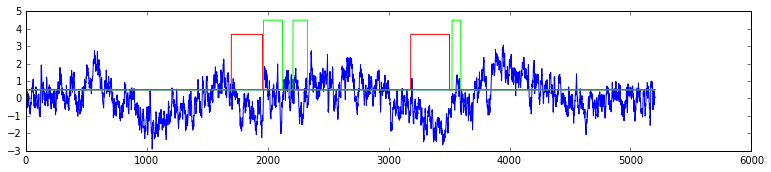


74


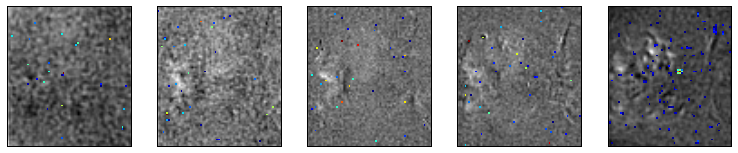

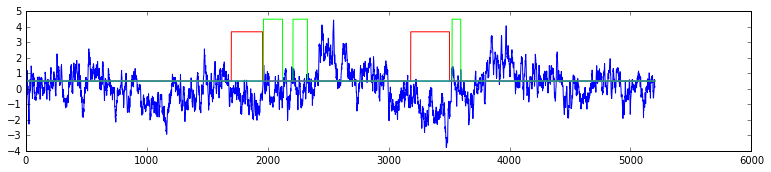

1
75


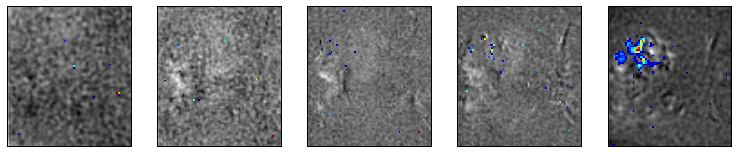

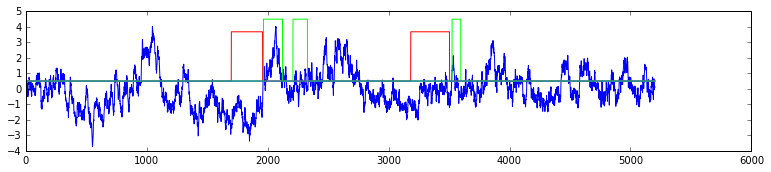

Dorsal
76


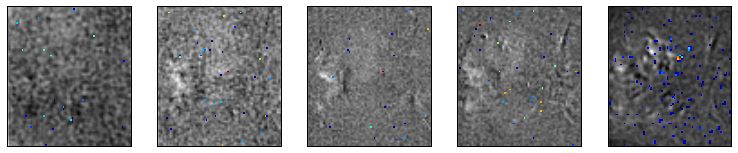

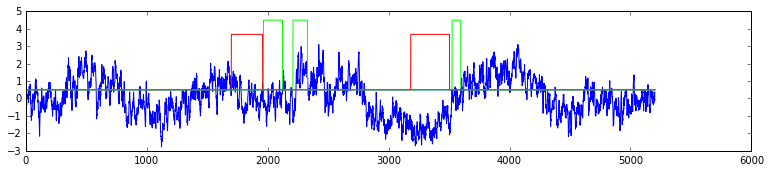


77


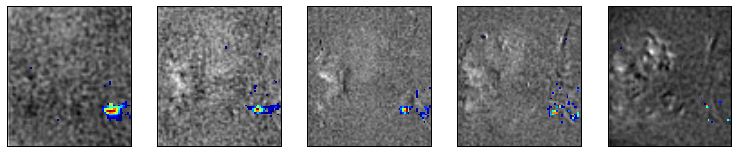

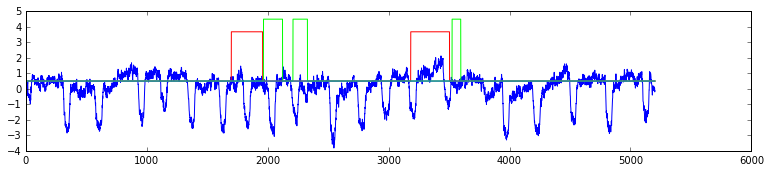


78


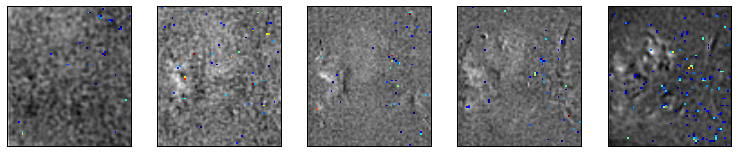

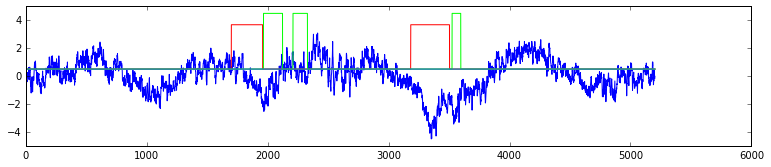


79


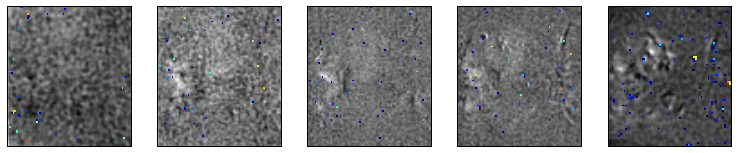

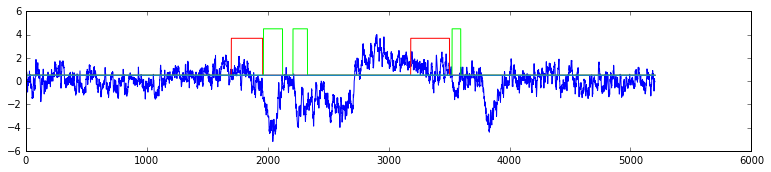


80


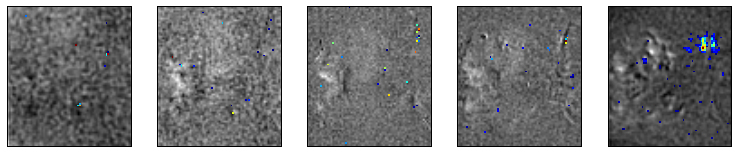

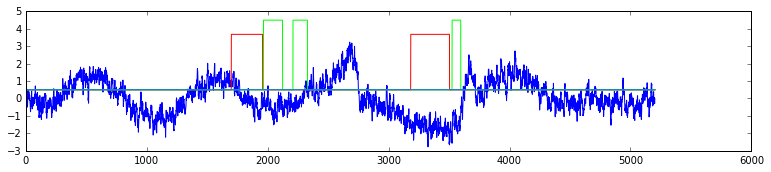


81


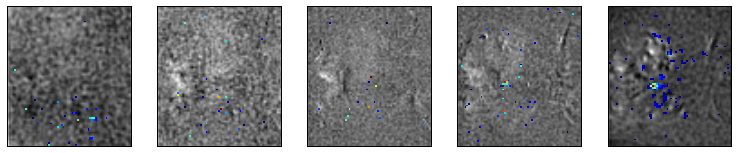

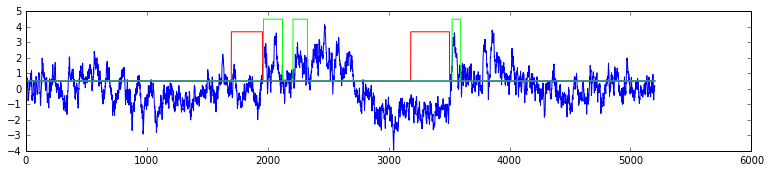


82


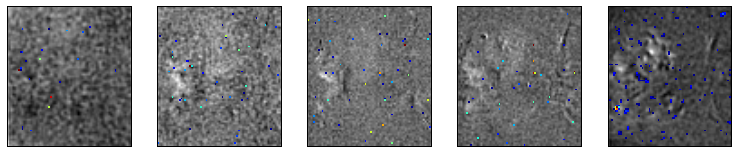

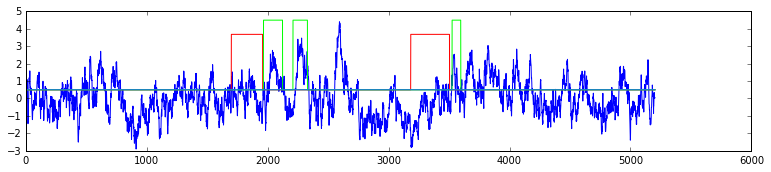


83


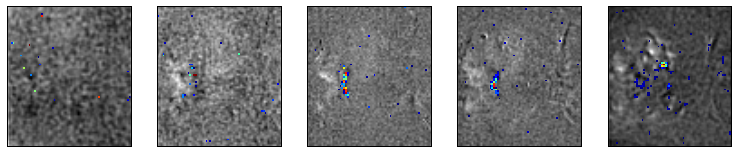

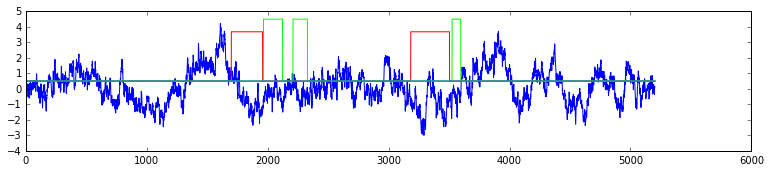

FB
84


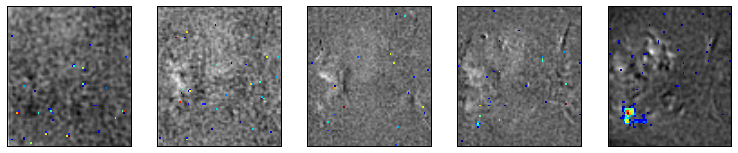

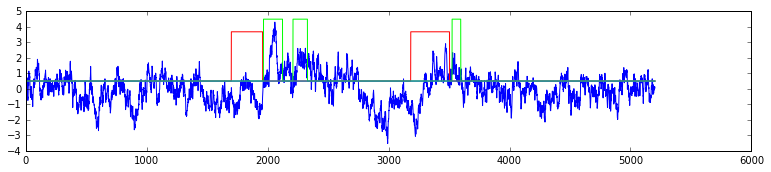


85


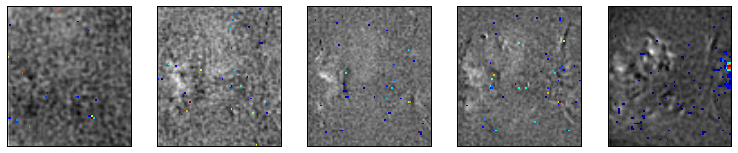

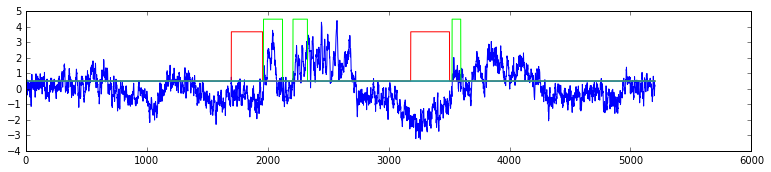


86


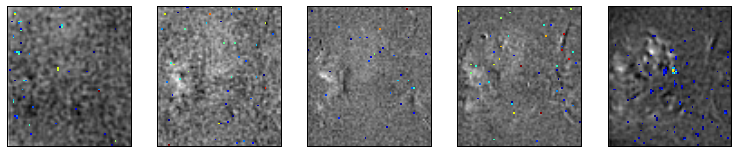

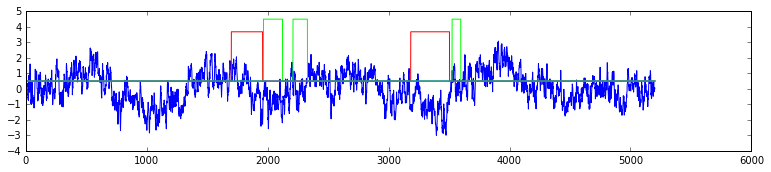


87


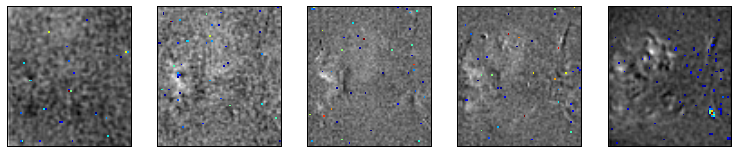

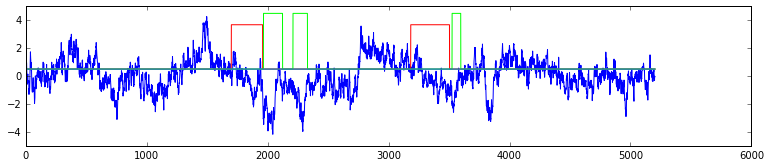


88


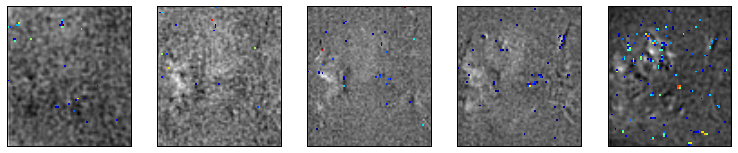

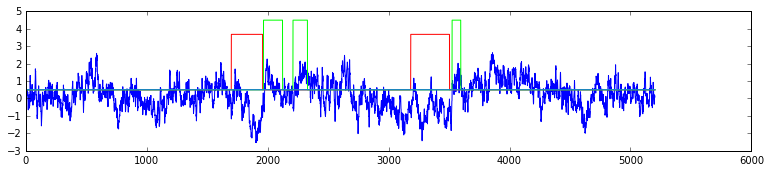


89


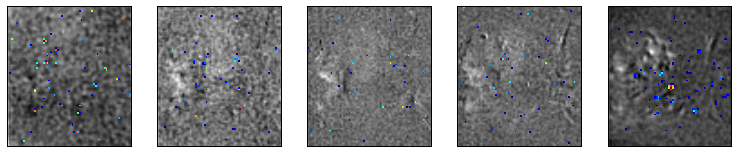

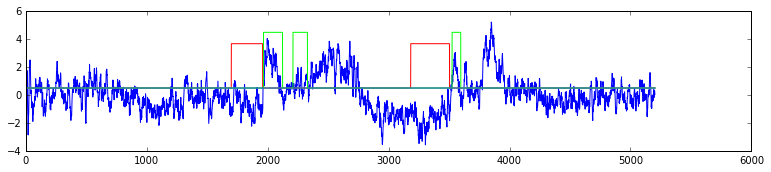


90


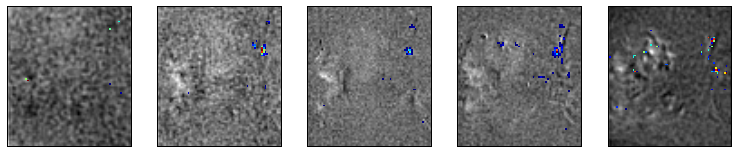

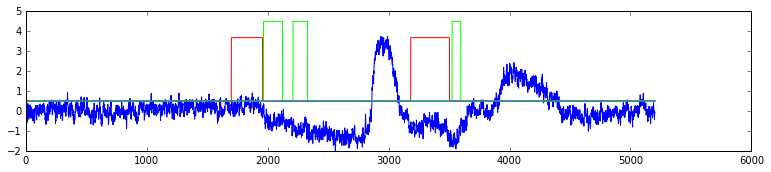


91


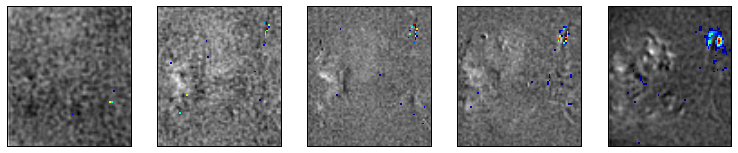

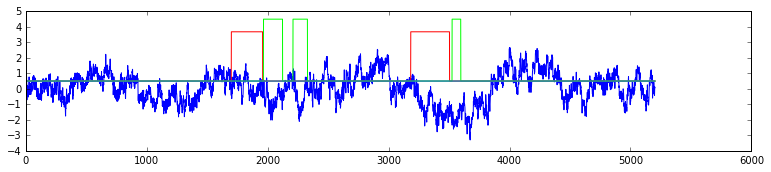


92


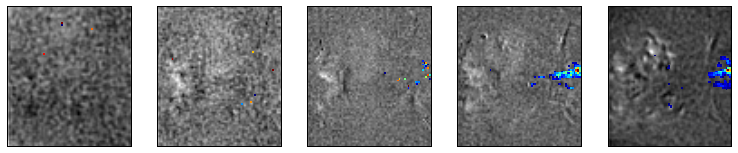

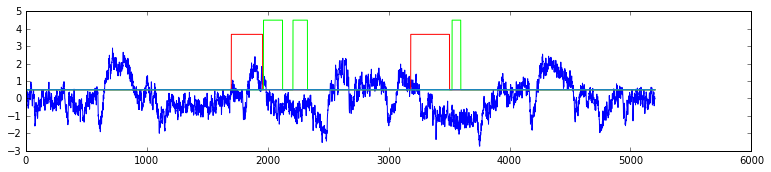


93


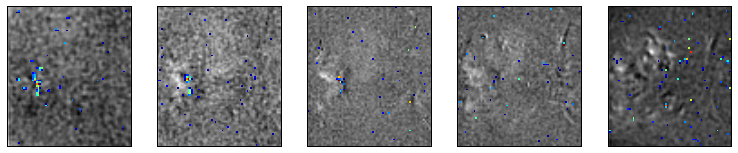

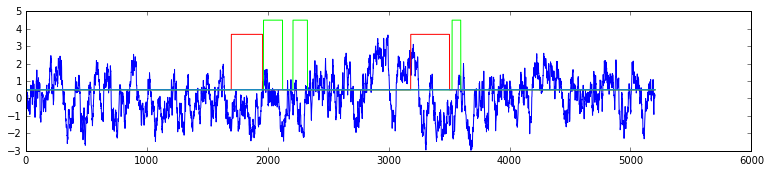

MB
94


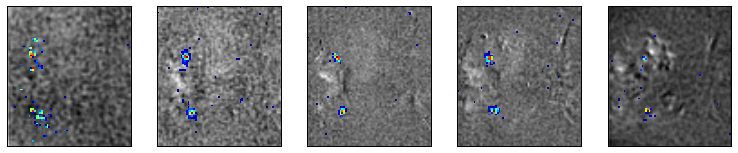

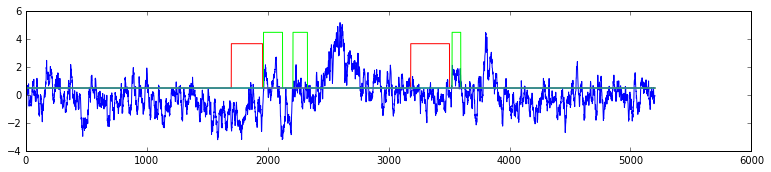

MB
95


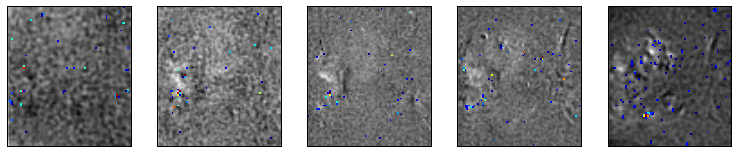

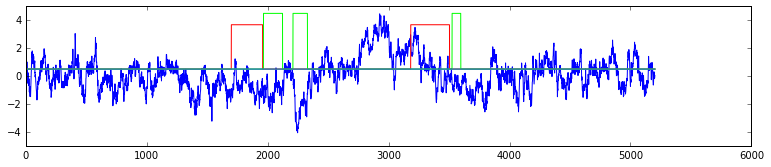


96


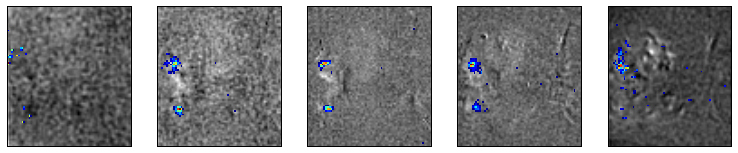

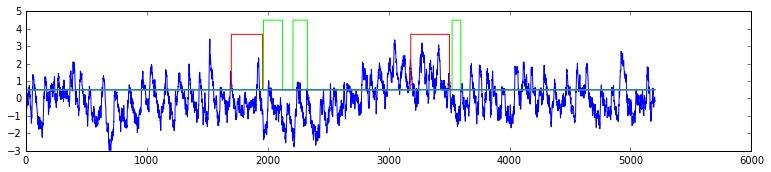

MB
97


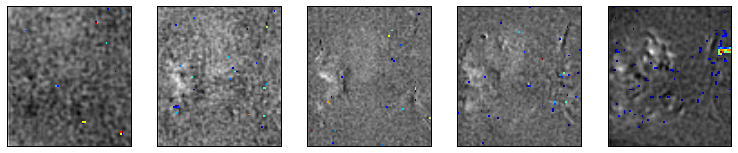

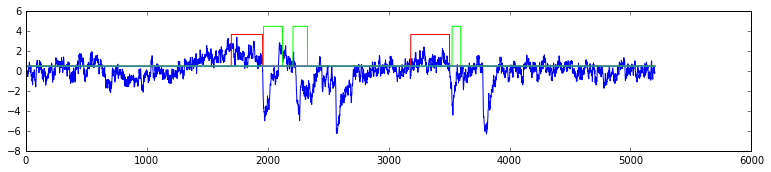


98


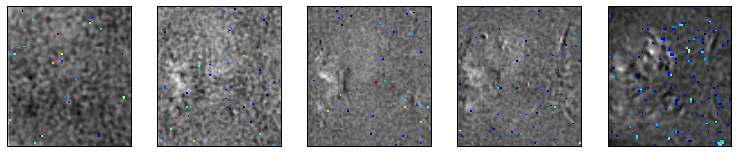

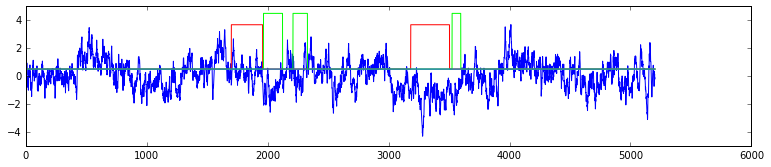


99


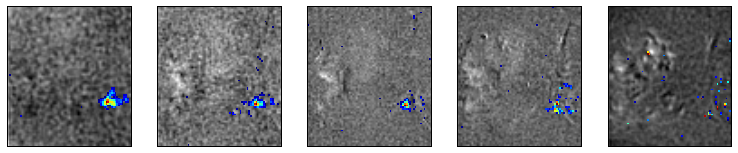

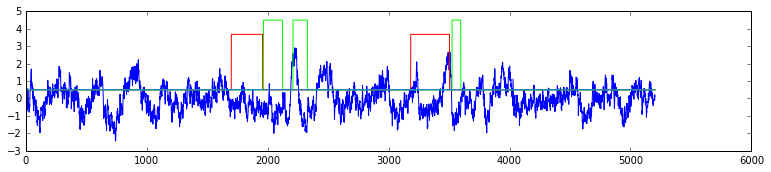


100


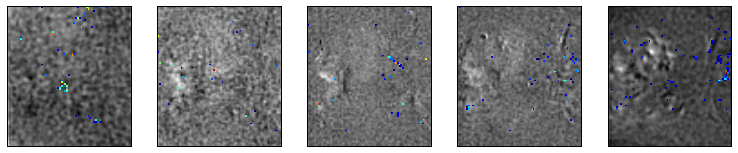

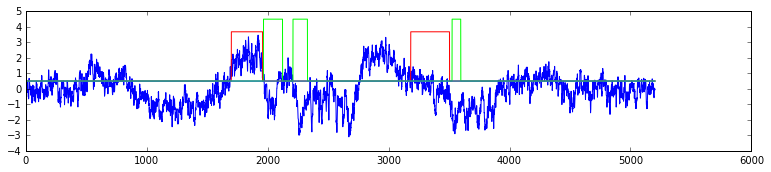


101


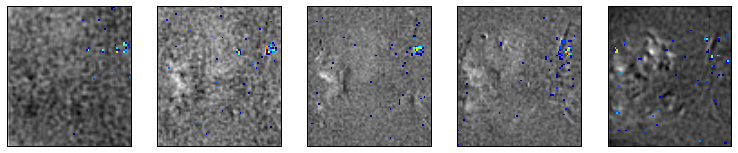

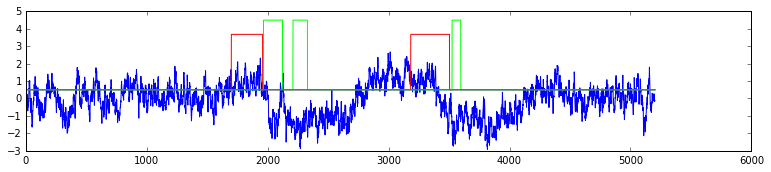


102


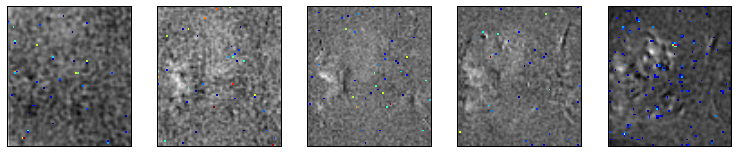

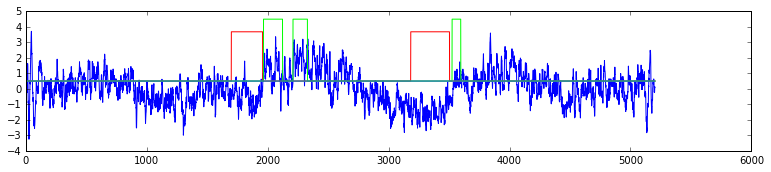


103


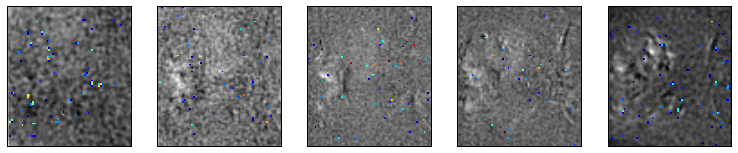

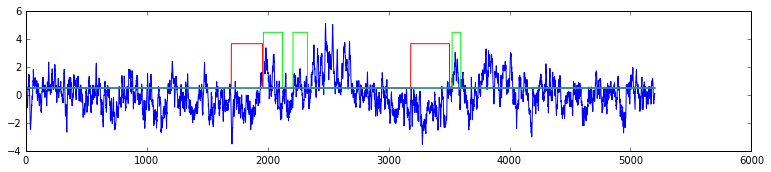


104


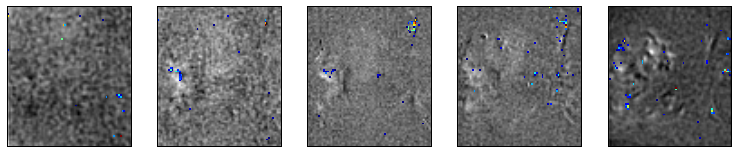

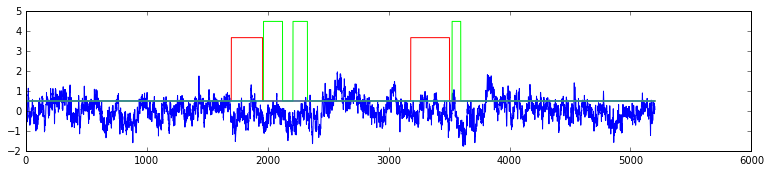


105


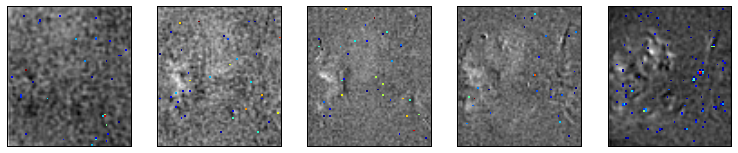

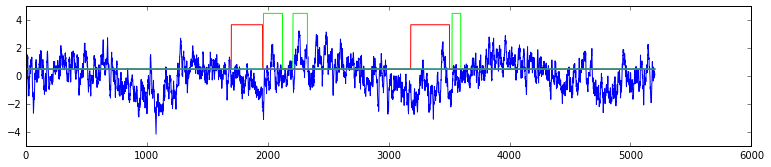


106


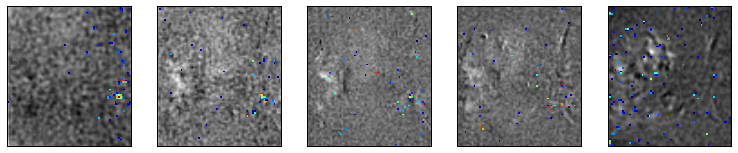

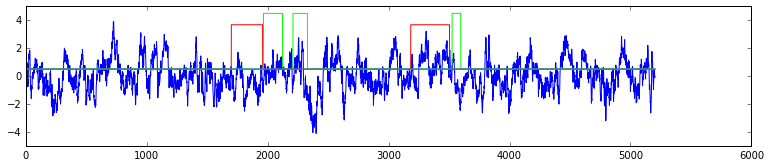


107


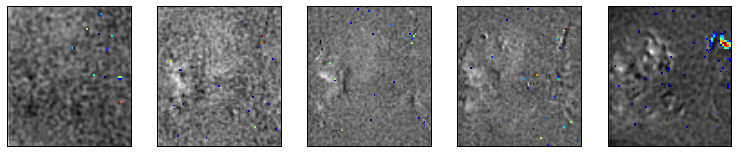

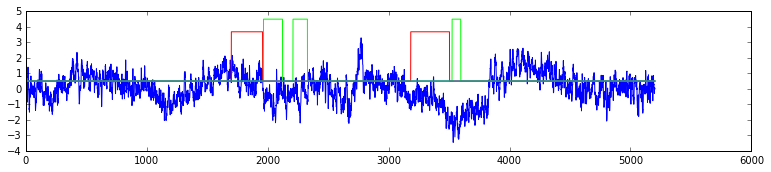


108


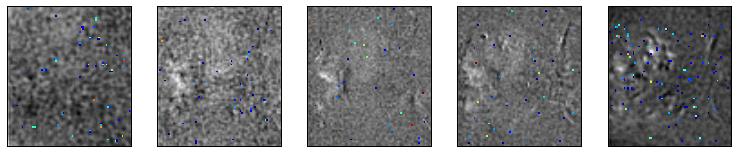

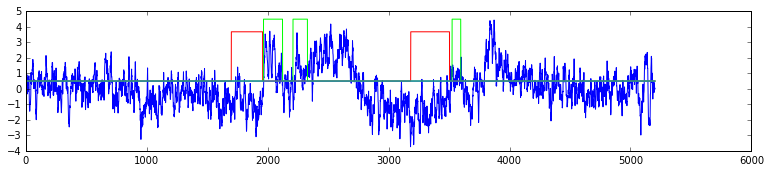


109


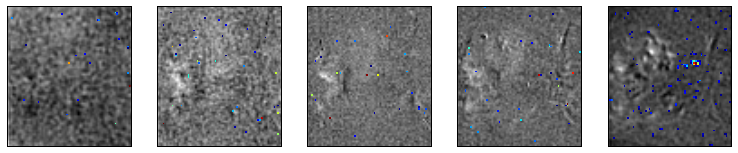

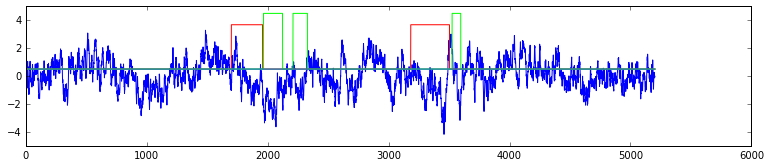


110


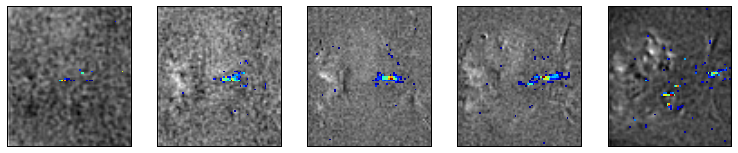

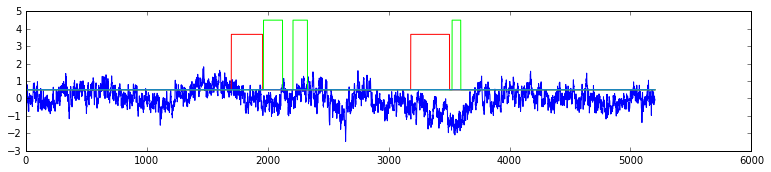


111


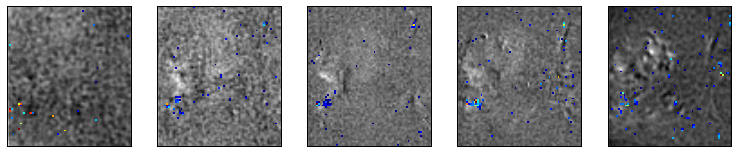

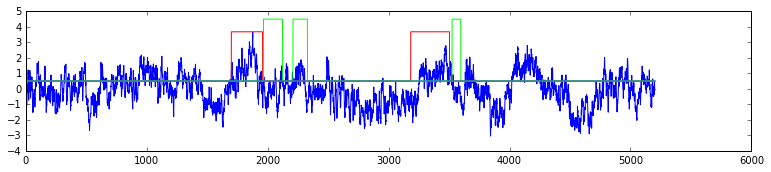


112


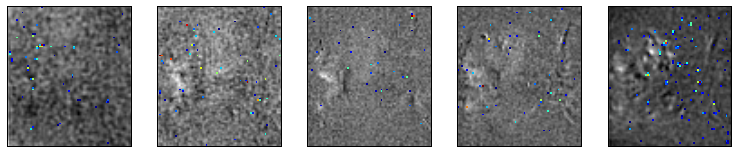

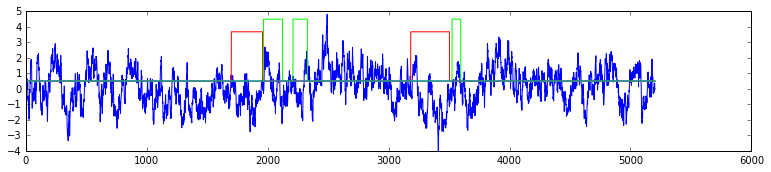


113


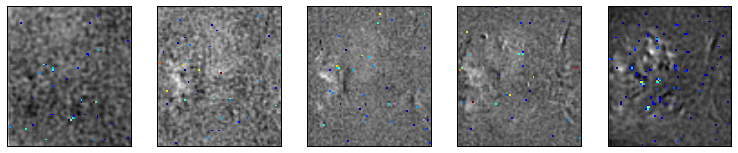

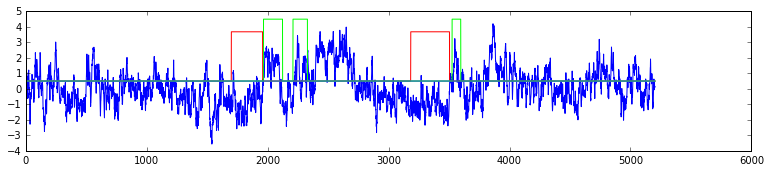


114


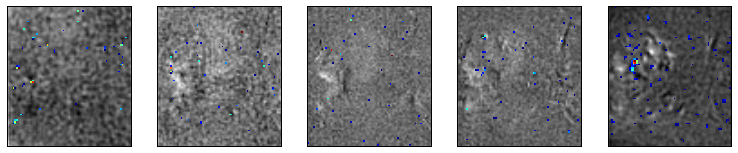

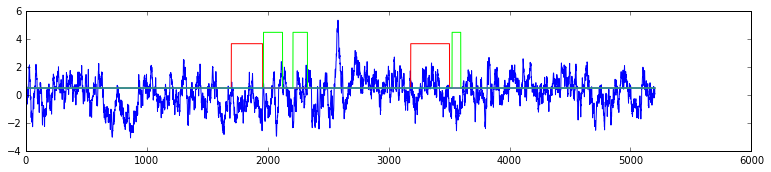


115


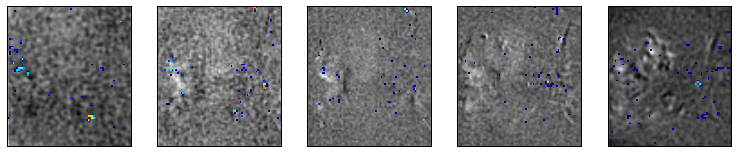

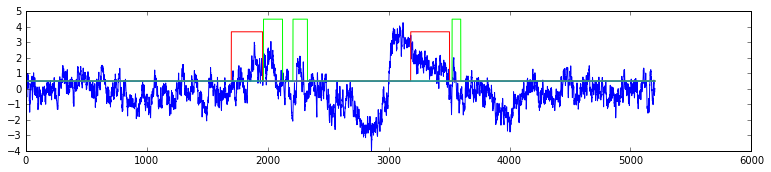


116


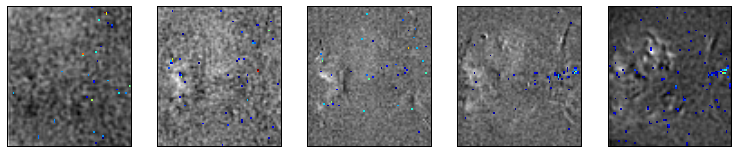

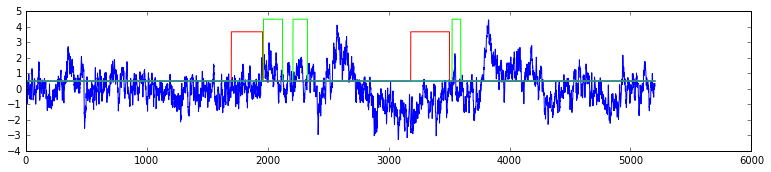


117


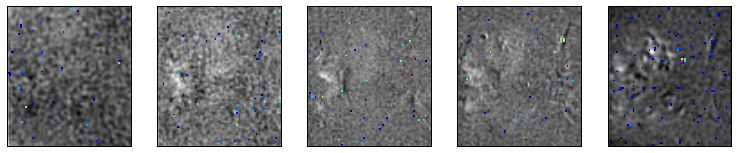

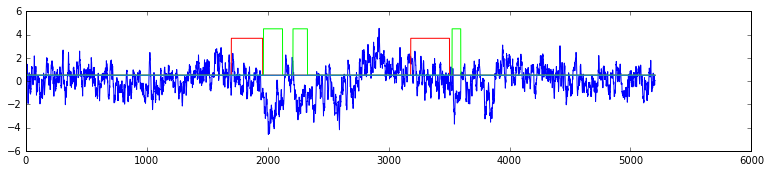


118


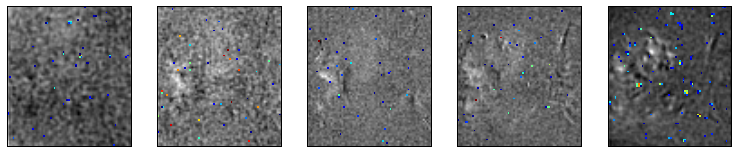

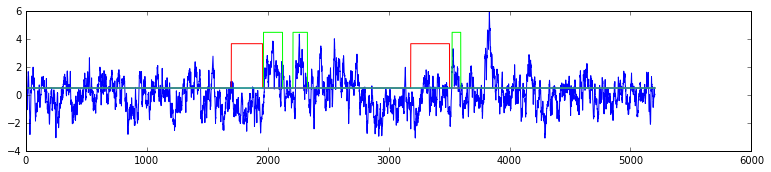


119


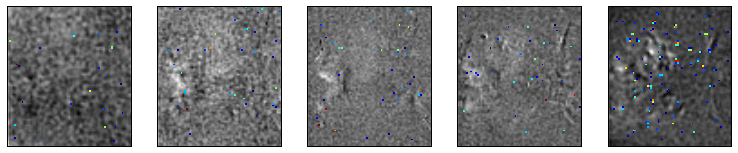

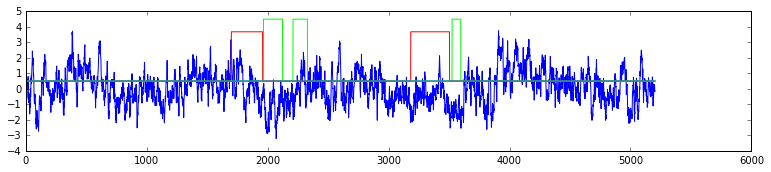


120


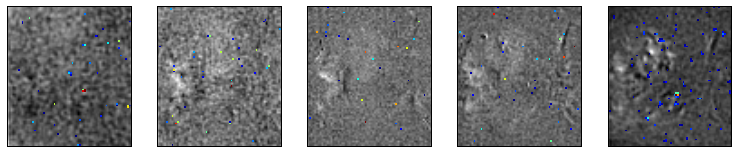

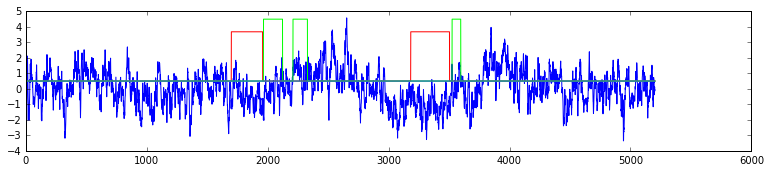


121


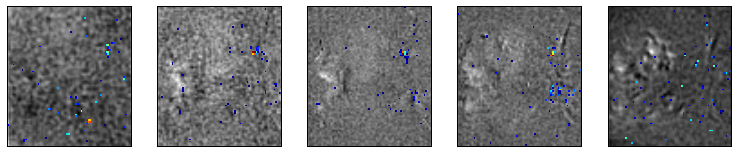

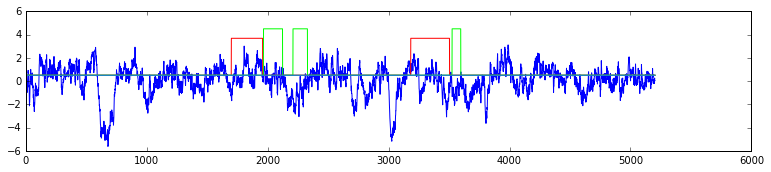


122


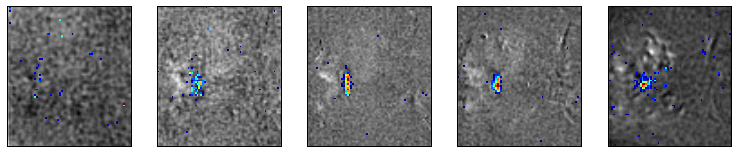

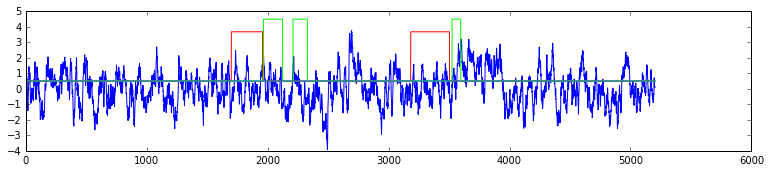

FB
123


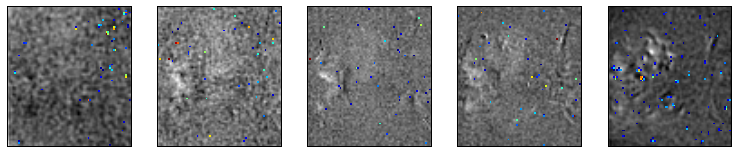

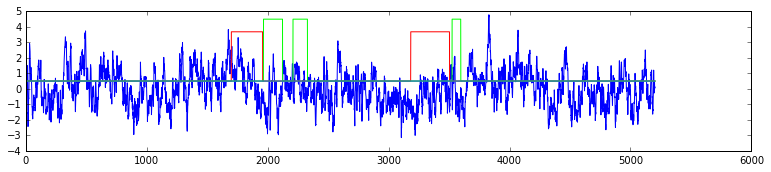


124


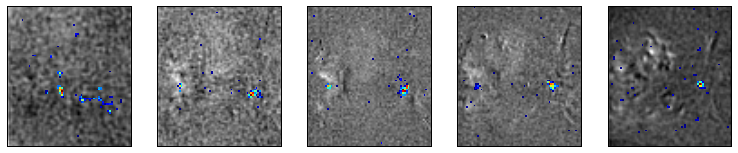

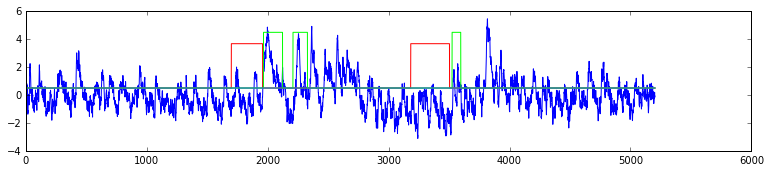


125


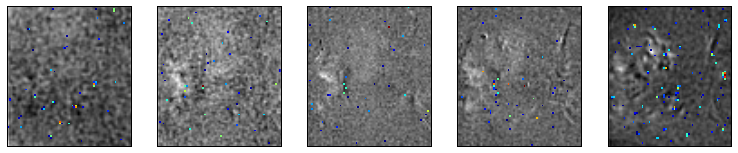

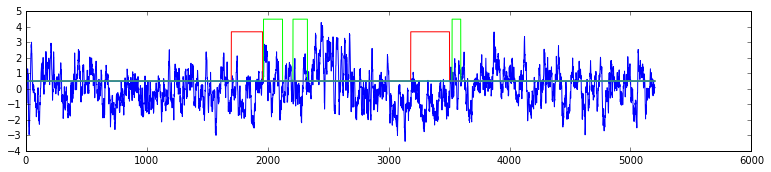


126


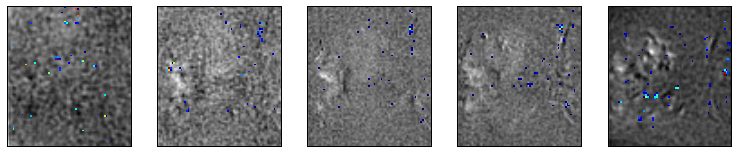

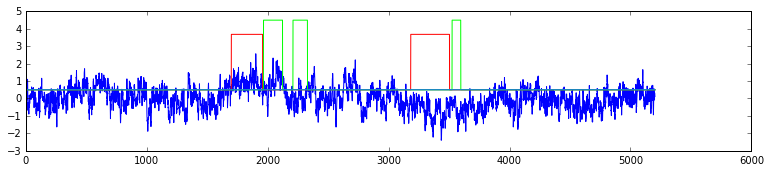


127


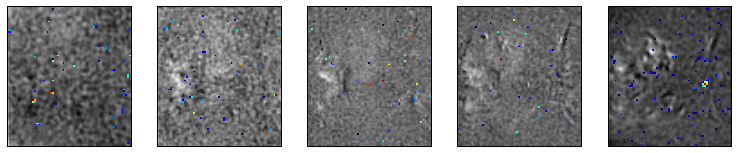

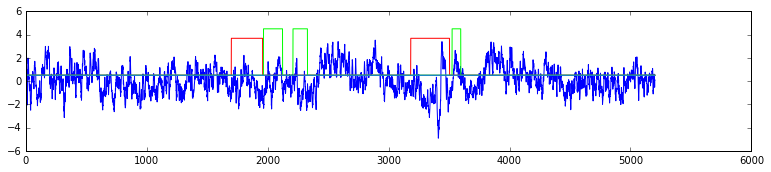


128


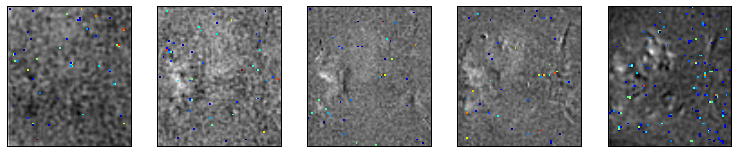

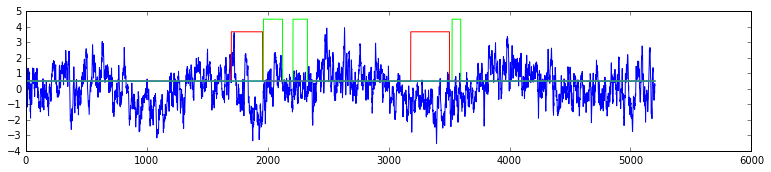


129


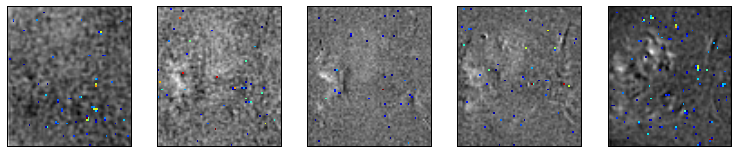

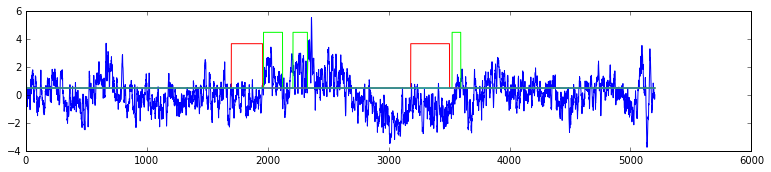


130


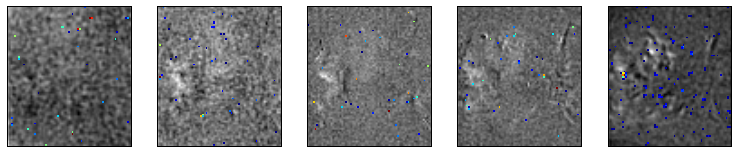

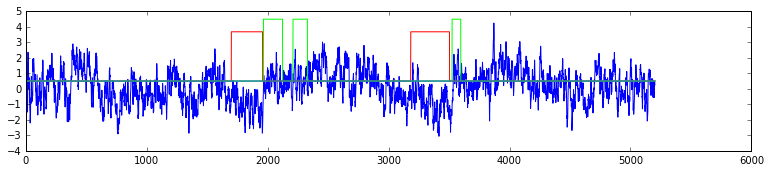


131


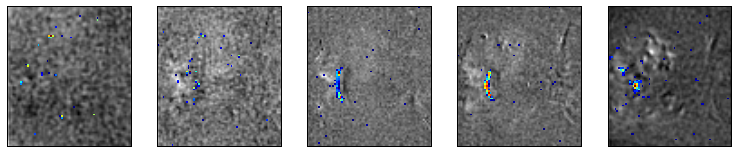

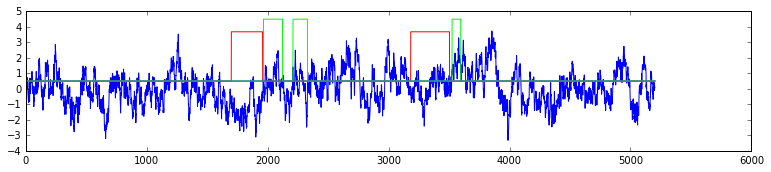

FB
132


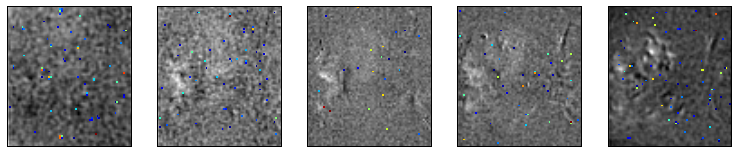

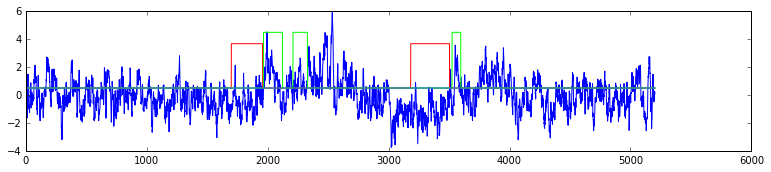


133


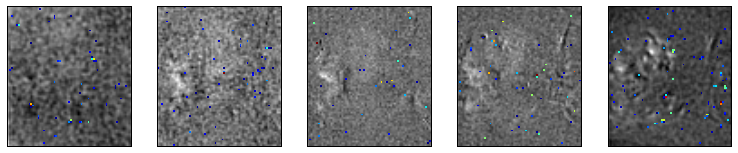

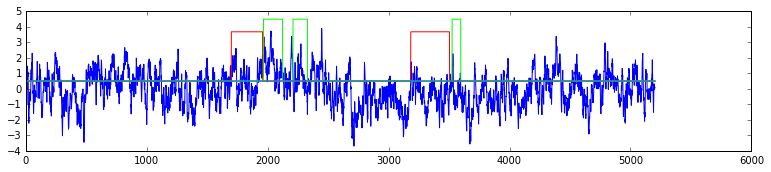


134


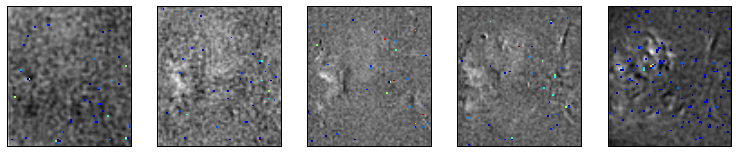

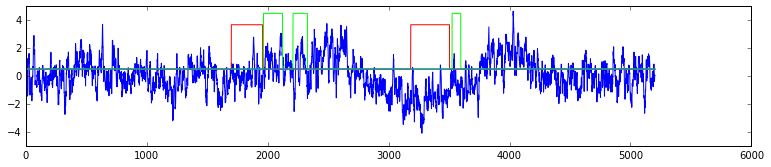


135


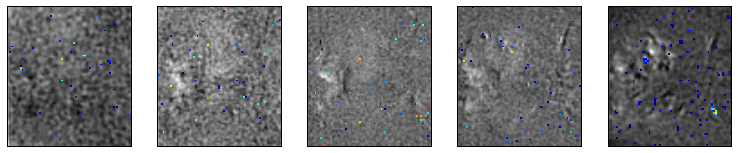

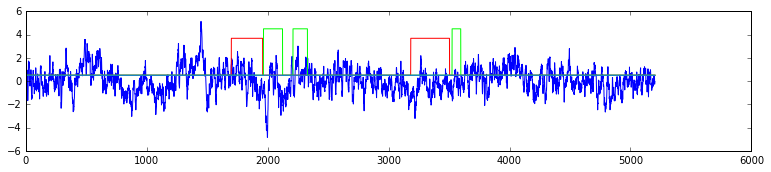


136


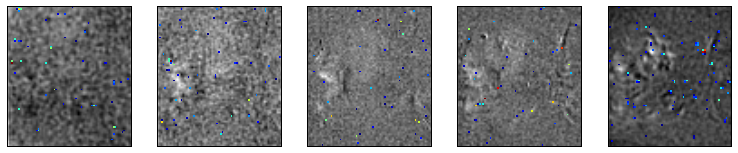

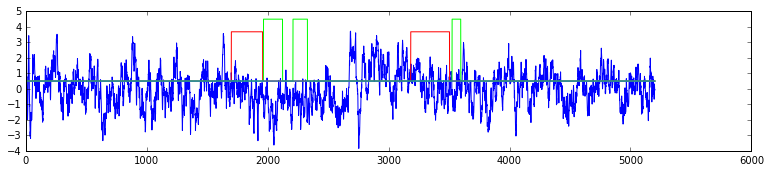


137


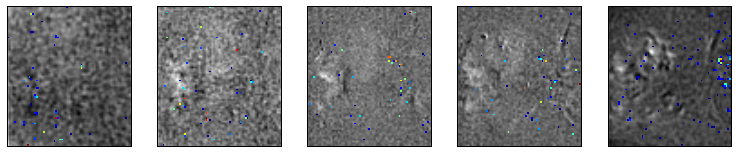

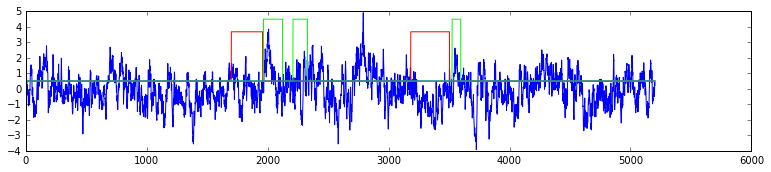


138


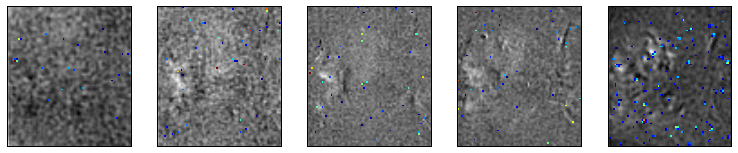

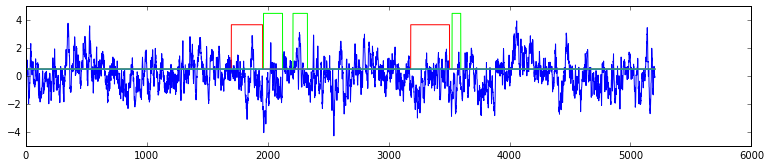


139


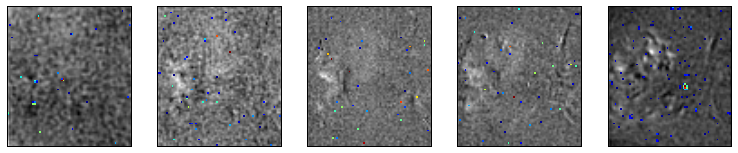

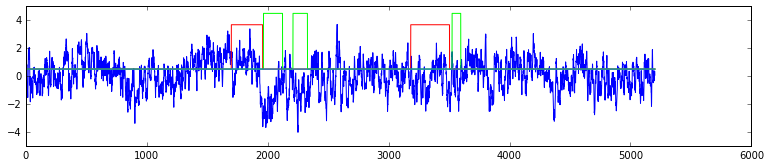


140


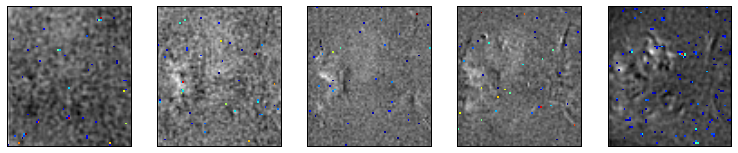

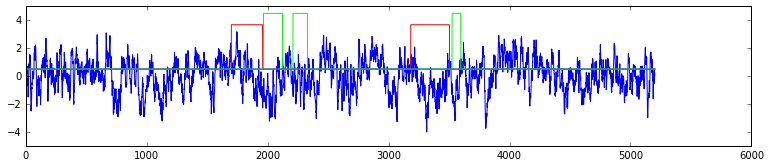


141


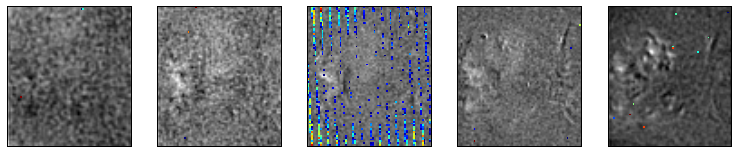

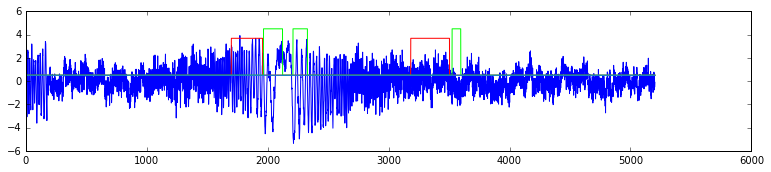


142


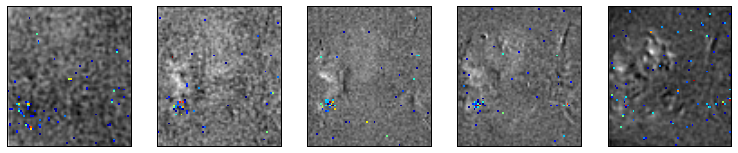

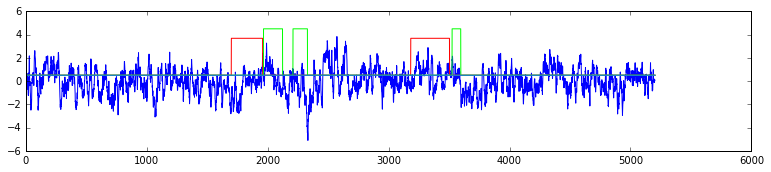


143


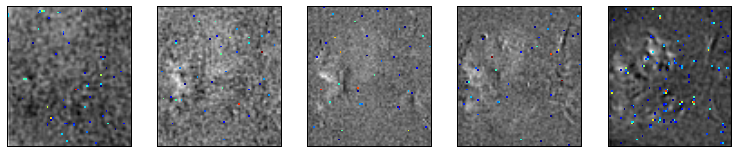

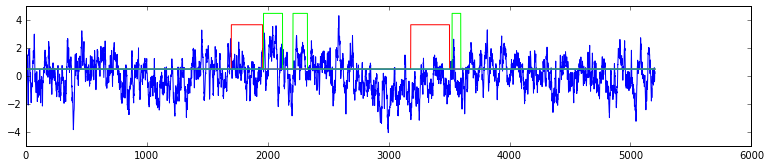


144


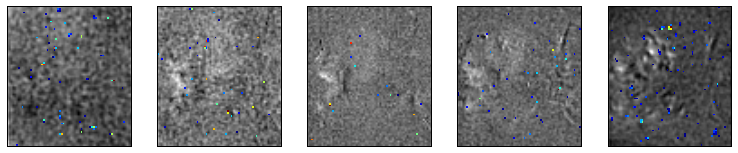

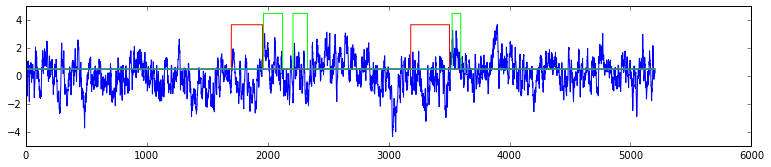


145


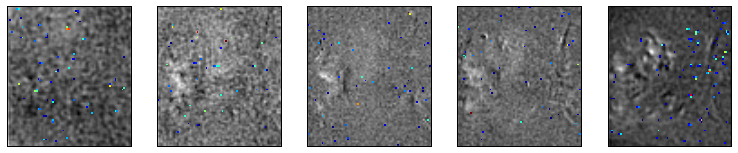

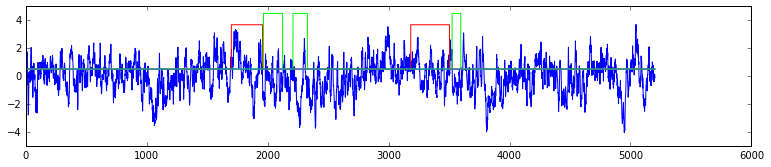


146


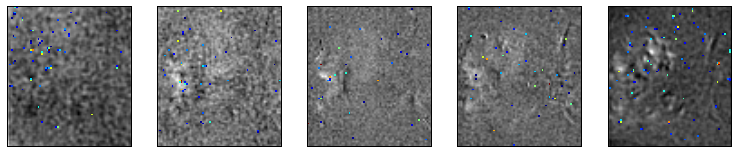

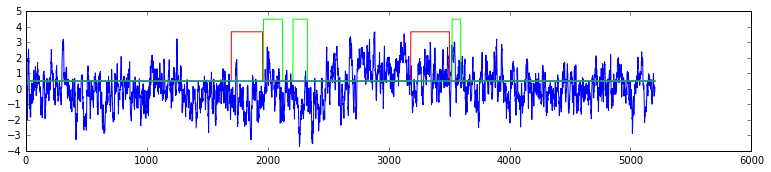


147


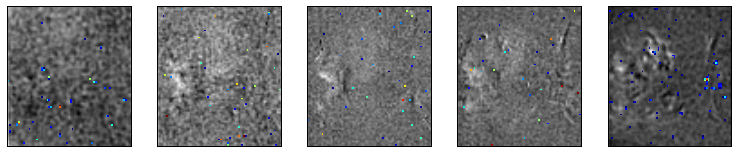

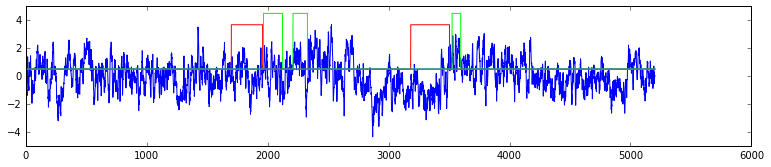


148


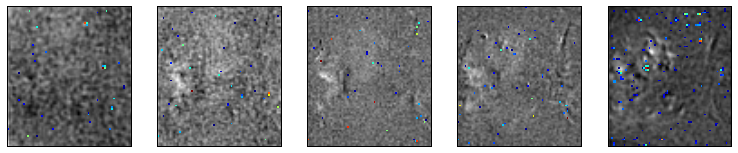

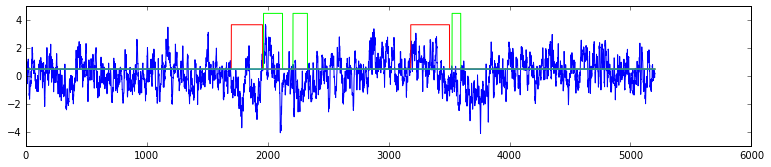


149


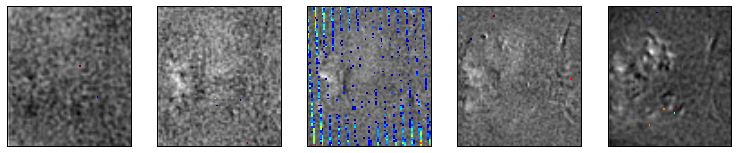

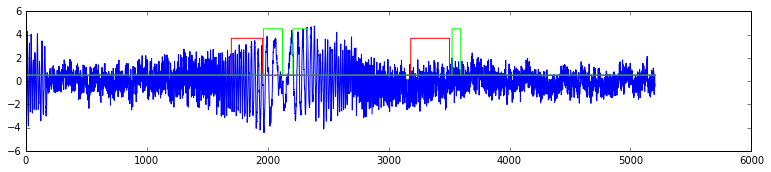


150


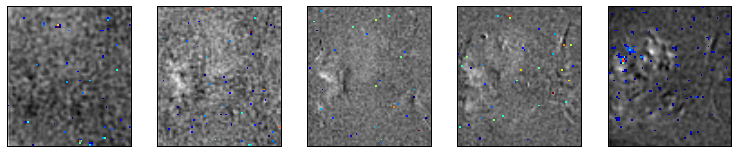

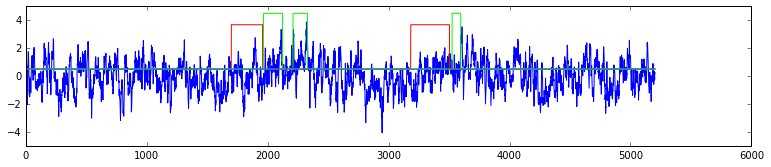


151


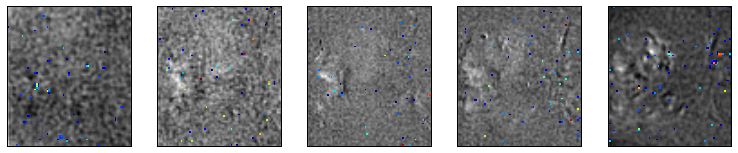

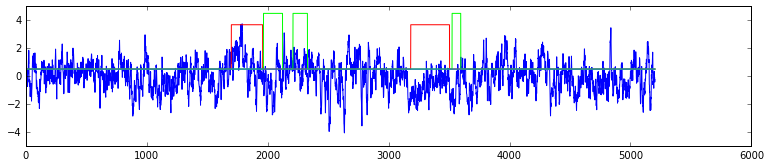


152


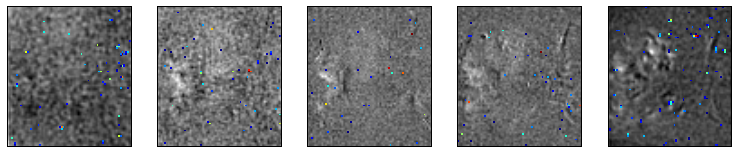

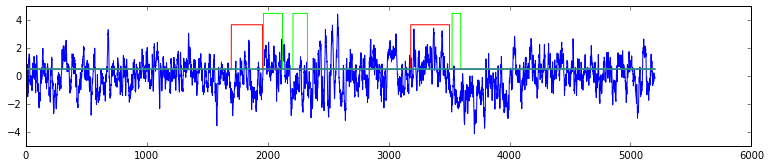


153


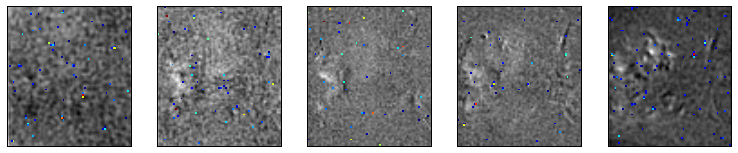

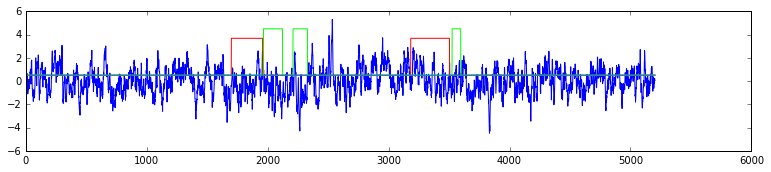


154


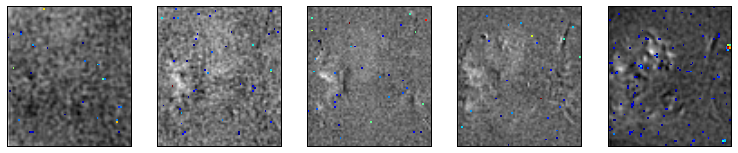

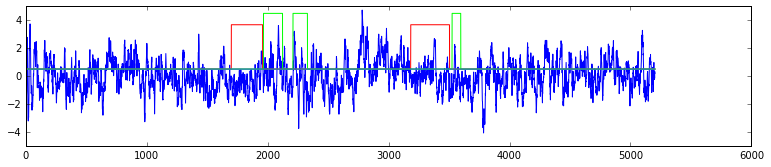


155


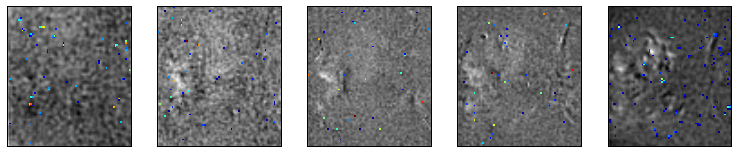

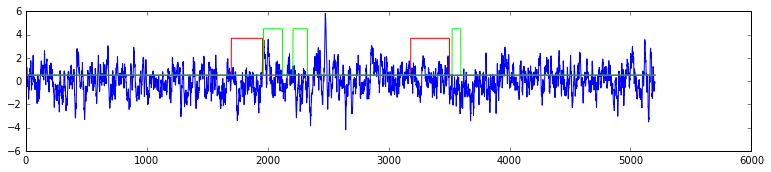

In [37]:
Label_ICs=[]
for j in range(S[3]):

    if S[2]>5:
        for i in range(Nstack):
            V=Dmaps[:,:,Indices[i],j]
            D1[:,:,i]=np.max(V,2)
        D2[:,:,:,j]=D1
        D1[D1==0]=np.nan
           
    else:
        for i in range(S[2]):
            V=Dmaps[:,:,i,j]
            D1[:,:,i]=V 
            

    print(j)
    for i in range(Nstack):
        plt.subplot(1,5,i+1)
        plt.imshow(Dmean[:,:,i],cmap=plt.cm.gray)
        plt.imshow(D1[:,:,i], cmap=my_cmap,interpolation='none')
        frame1 = plt.gca()
        frame1.axes.get_xaxis().set_visible(False)
        frame1.axes.get_yaxis().set_visible(False)
        
    plt.show()
    
   # plt.plot(TS_ROI[Order[j],:])
    plt.plot(DTvarnew[:,j])
    plt.plot(Xk[0,:]/np.std(Xk[0,:])+0.5,color=(1,0,0))   
    plt.plot(Xk[1,:]/np.std(Xk[1,:])+0.5,color=(0,1,0))
    plt.plot(Xk[2,:]/np.std(Xk[1,:])+0.5,color=(0.5,0.5,0))    
    plt.plot(Xk[3,:]/np.std(Xk[1,:])+0.5,color=(0,0.5,1))
    
    plt.show()
    
    Label_ICs.append(raw_input())
    if Label_ICs[j]=='':
        Good_ICs[j]=0
    else:
        Good_ICs[j]=1
        
        

93


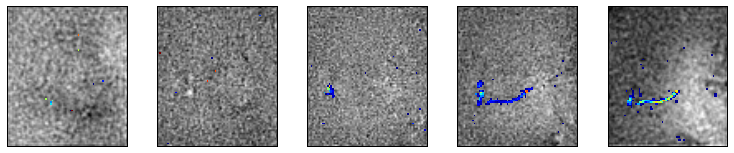

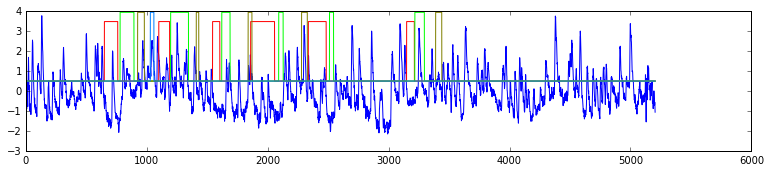

110


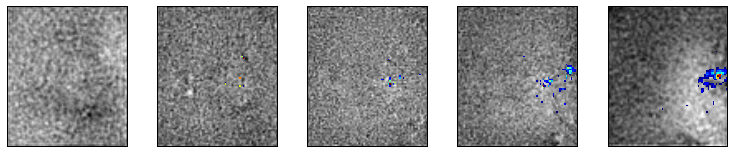

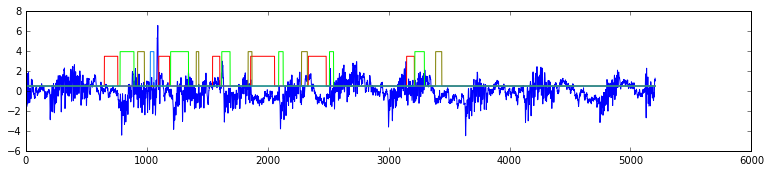

112


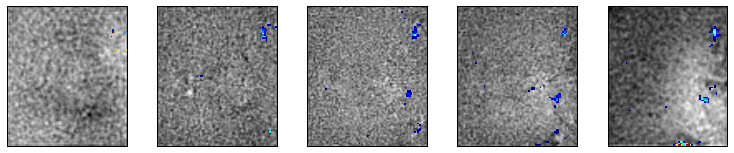

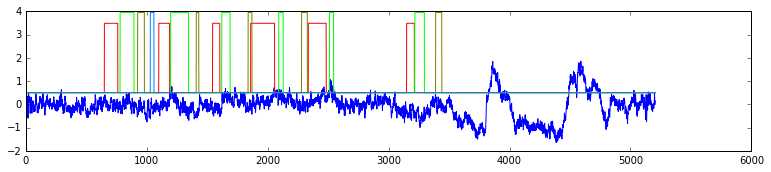

113


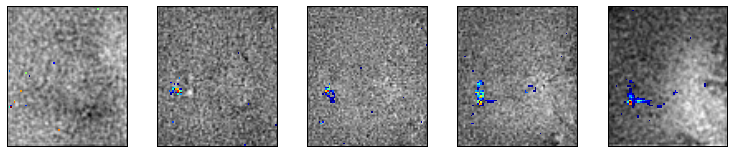

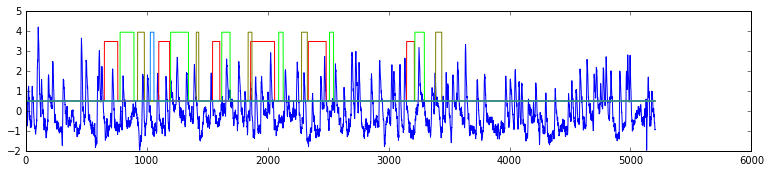

115


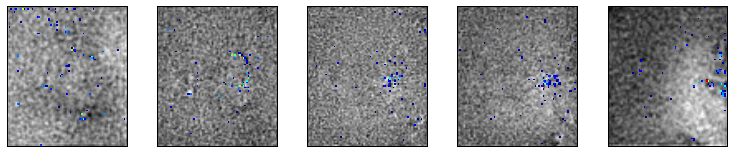

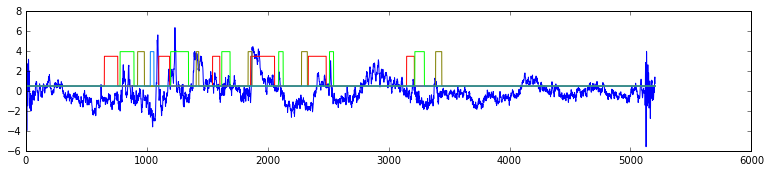

123


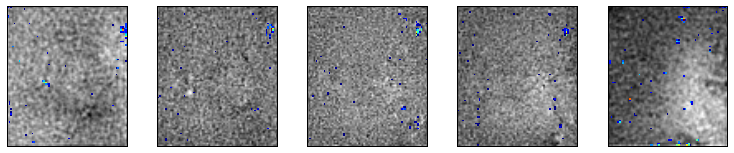

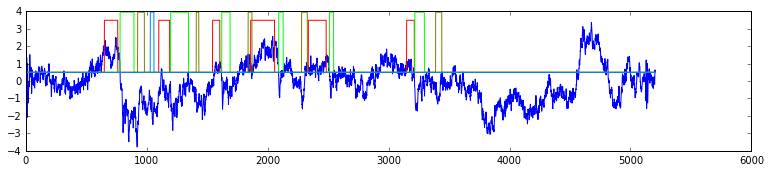

130


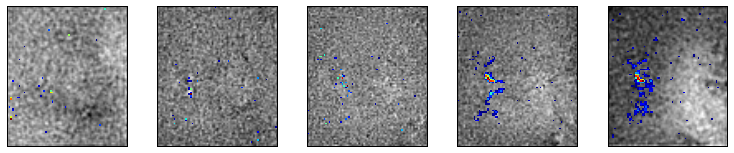

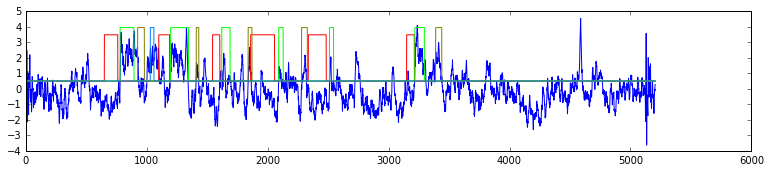

134


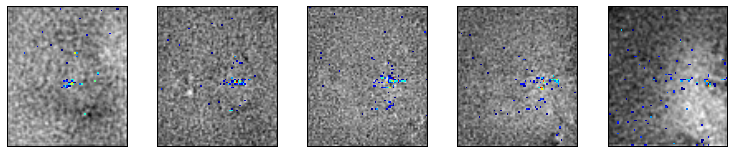

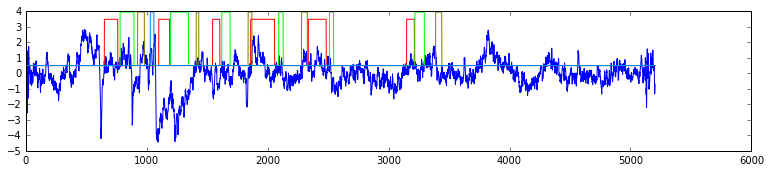

146


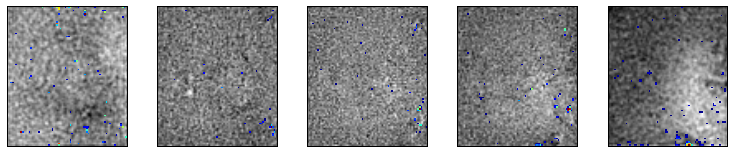

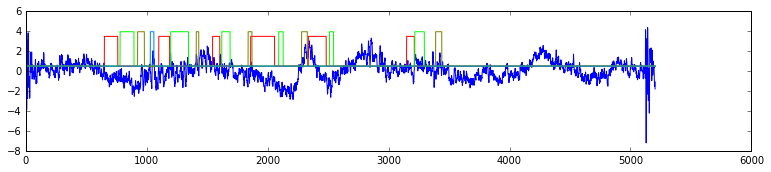

150


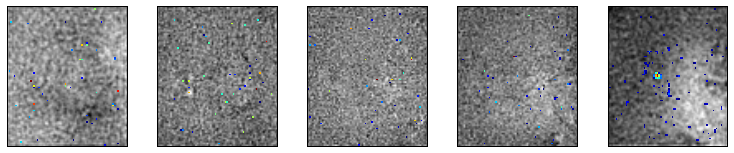

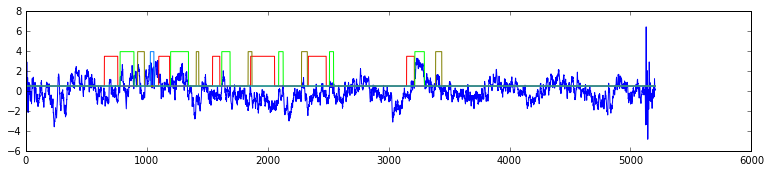

154


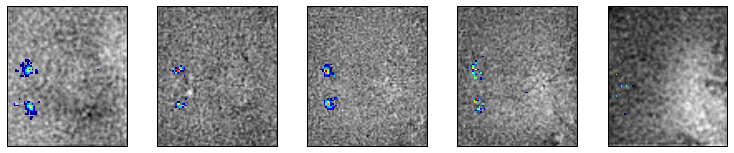

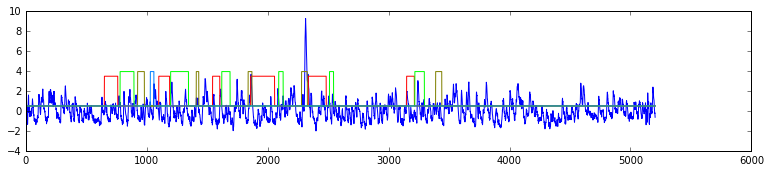

155


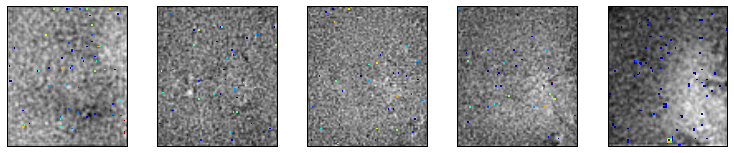

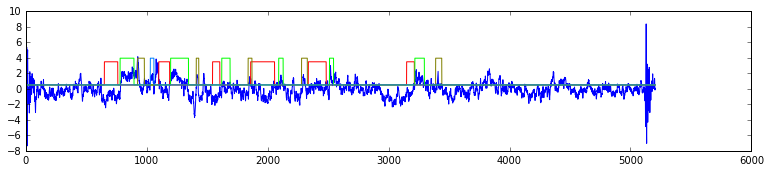

163


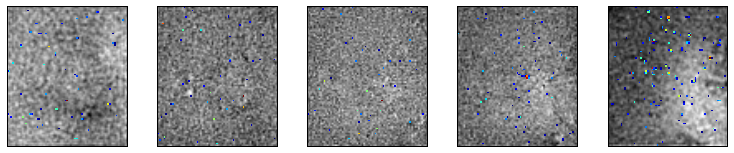

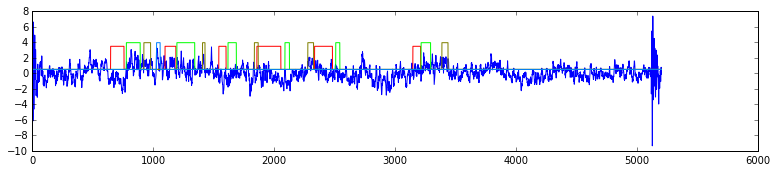

169


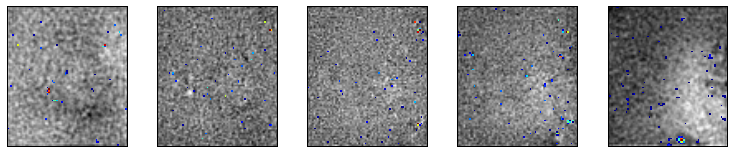

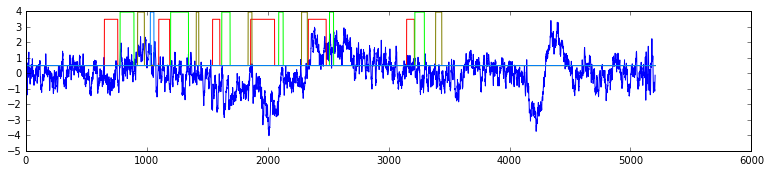

175


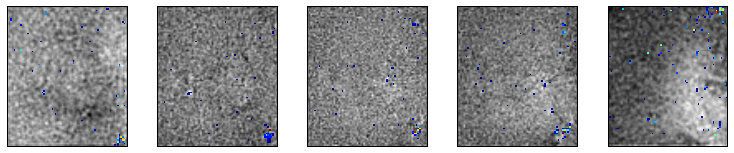

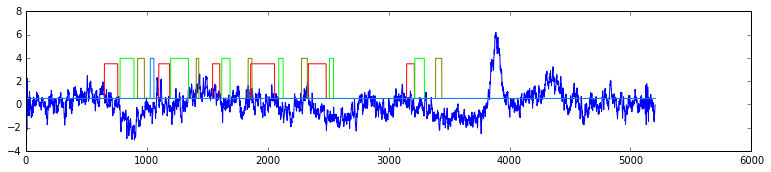

176


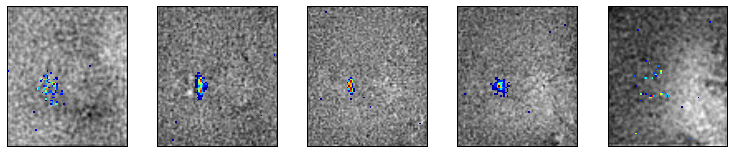

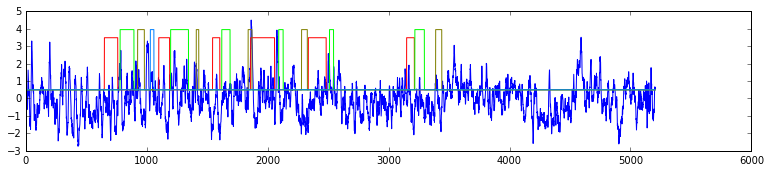

179


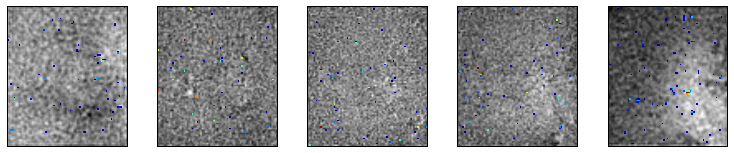

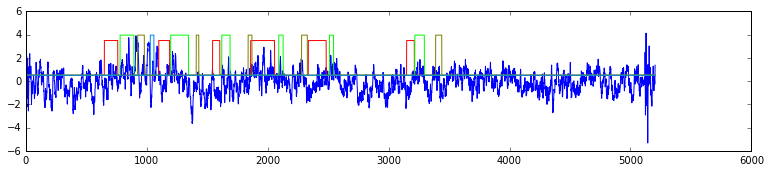

181


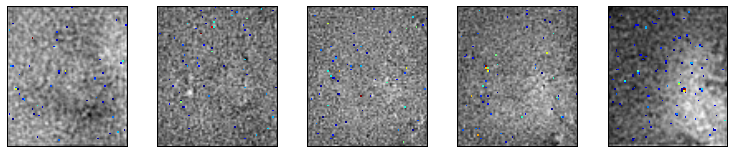

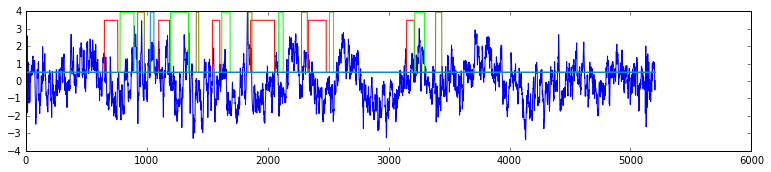

182


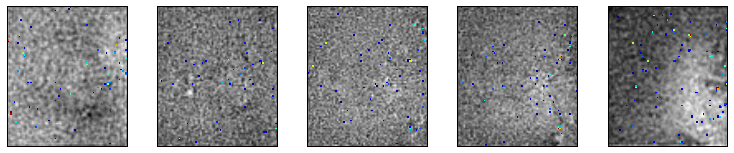

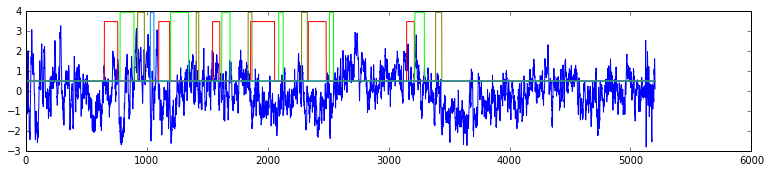

185


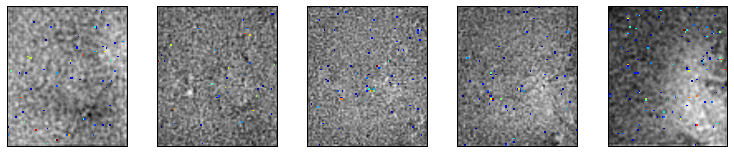

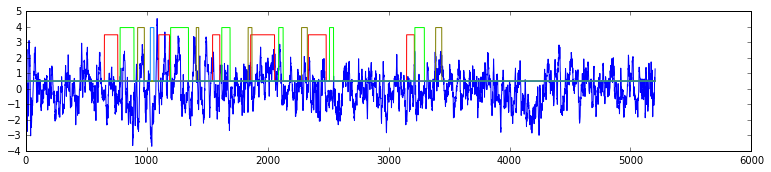

In [75]:
for j in range(S[3]):

    if Good_ICs[j]==1:       
        if S[2]>5:
            for i in range(Nstack):
                V=Dmaps[:,:,Indices[i],j]
                D1[:,:,i]=np.max(V,2)
            D2[:,:,:,j]=D1
            D1[D1==0]=np.nan
           
        else:
            for i in range(S[2]):
                V=Dmaps[:,:,i,j]
                D1[:,:,i]=V 
            

        print(j)
        for i in range(Nstack):
            plt.subplot(1,5,i+1)
            plt.imshow(Dmean[:,:,i],cmap=plt.cm.gray)
            plt.imshow(D1[:,:,i], cmap=my_cmap,interpolation='none')
            frame1 = plt.gca()
            frame1.axes.get_xaxis().set_visible(False)
            frame1.axes.get_yaxis().set_visible(False)
        
        plt.show()
    
   # plt.plot(TS_ROI[Order[j],:])
        plt.plot(DTvarnew[:,j])
        plt.plot(Xk[0,:]/np.std(Xk[0,:])+0.5,color=(1,0,0))   
        plt.plot(Xk[1,:]/np.std(Xk[1,:])+0.5,color=(0,1,0))
        plt.plot(Xk[2,:]/np.std(Xk[1,:])+0.5,color=(0.5,0.5,0))    
        plt.plot(Xk[3,:]/np.std(Xk[1,:])+0.5,color=(0,0.5,1))
    
        plt.show()

In [76]:
Label_ICs

['',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '1',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '1',
 '',
 '1',
 '1',
 '',
 '1',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '1',
 '',
 '',
 '',
 '',
 '',
 '',
 '1',
 '',
 '',
 '',
 '1',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '1',
 '',
 '',
 '',
 '1',
 '',
 '',
 '',
 '1',
 '1',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '1',
 '',
 '',
 '',
 '',
 '',
 '1',
 '',
 '',
 '',
 '',
 '',
 '1',
 '1',
 '',
 '',
 '1',
 '',
 '1',
 '1',
 '',
 '',
 '1',
 '',
 '1',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',

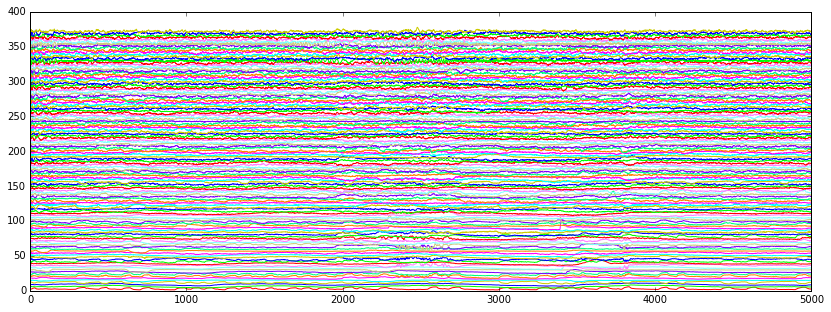

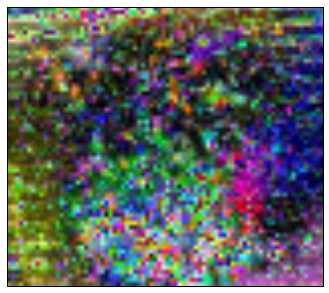

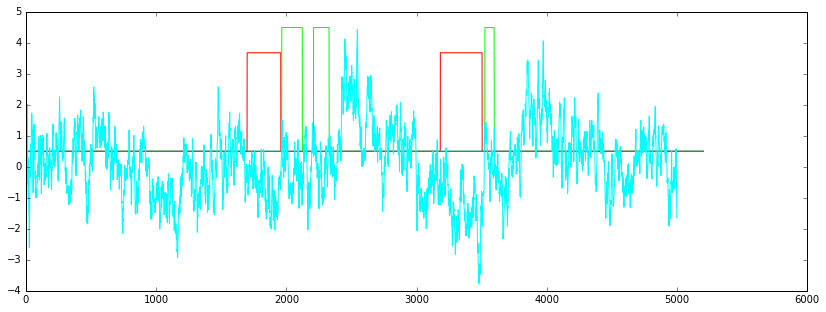

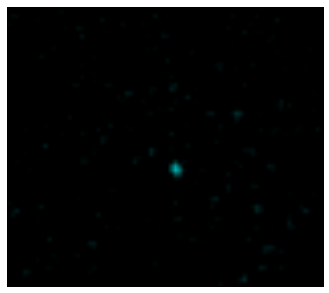

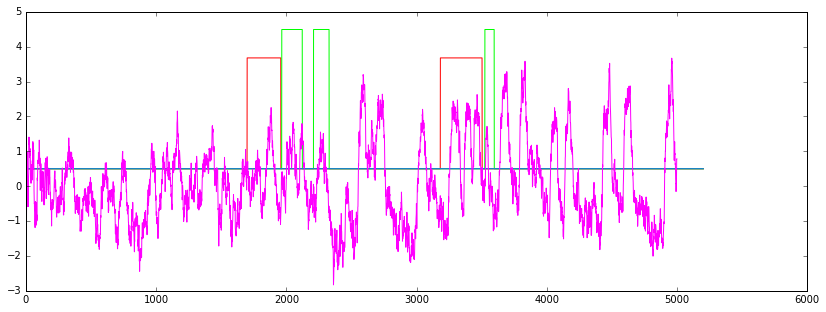

...

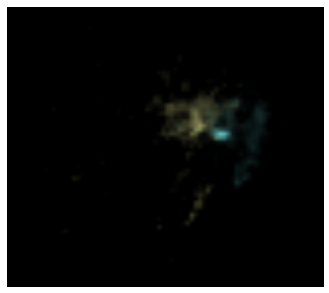

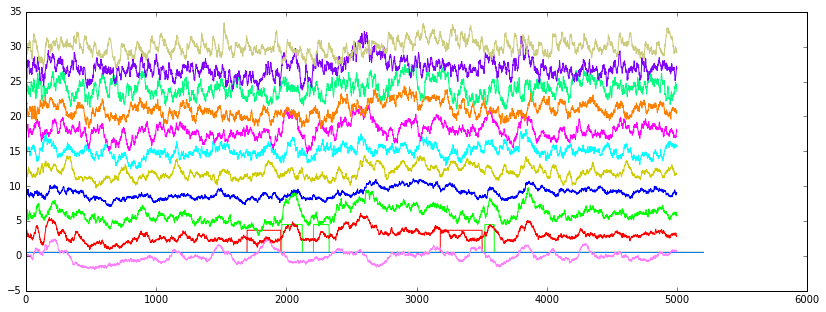

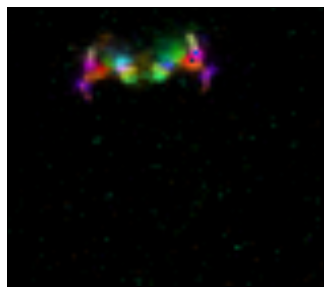

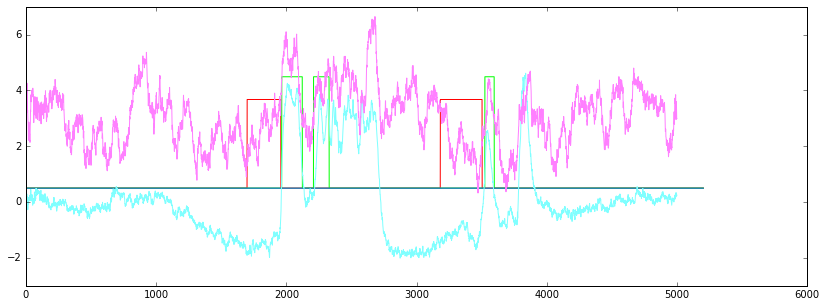

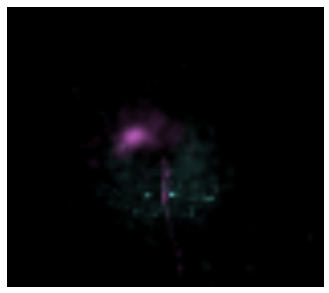

In [41]:
List1=[(Label_ICs[i],i) for i in range(S[3])]
Newlist=sorted(List1, key=lambda List1: List1[0])

Neworder=[Newlist[i][1] for i in range(S[3])]

NewDT=DTvar[:,Neworder[:]].T

for j in range(len(Neworder)):
    A=NewDT[:,j]
    V=np.sqrt(np.var(A))
    NewDT[:,j]=A/V

C1=np.zeros([12,3])
C1[0][:]=(1,0,0)
C1[1][:]=(0,1,0)
C1[2][:]=(0,0,1)
C1[3][:]=(0.8,0.8,0)
C1[4][:]=(0,1,1)
C1[5][:]=(1,0,1)
C1[6][:]=(1,0.5,0)
C1[7][:]=(0,1,0.5)
C1[8][:]=(0.5,0,1)
C1[9][:]=(0.8,0.8,0.5)
C1[10][:]=(0.5,1,1)
C1[11][:]=(1,0.5,1)
h=3

Newmaps=Dmaps[:,:,:,Neworder[:]]

L=len(set([Label_ICs[Neworder[i]] for i in range(len(Neworder))]))

Regionmaps=np.zeros([S[0],S[1],L,3])
Datasort=np.zeros([S[0],S[1],S[2],L,3])

Regionname=[]

DMapsordered=Dmapso[:,:,:,Neworder[:]]

DMapsordered=Dmapso[:,:,:,Neworder[:]]

j=0
i=0
k=Label_ICs[Neworder[0]]
m=0
Regionname.append(Label_ICs[Neworder[i]])
for i in range(len(Neworder)):
    #C2=C1[i%6][:]
    for l in range(3):
        M=np.max(np.squeeze(np.reshape(Newmaps[:,:,:,i],S[0]*S[1]*S[2])))
        Regionmaps[:,:,j,l]=Regionmaps[:,:,j,l]+0.7*np.max(DMapsordered[:,:,:,i],2)*C1[i%12][l]/M
        Datasort[:,:,:,j,l]=Datasort[:,:,:,j,l]+Dmaps[:,:,:,Neworder[i]]*C1[i%12][l] 
    i=i+1
    m=m+1
    if i<len(Neworder):
        k1=Label_ICs[Neworder[i]]
        
    if k1 != k:
        j=j+1
        k=k1
        m=0
        Regionname.append(Label_ICs[Neworder[i]])

pylab.rcParams['figure.figsize'] = (14, 5)
import scipy
from scipy import ndimage
j=0
m=0
L=0
k=Label_ICs[Neworder[0]]
for i in range(len(Neworder)):
    m=m+1
    
    
    if i<len(Neworder):
        k1=Label_ICs[Neworder[i]]
        
    if k1 != k:
        
        k=k1
        m=0
        
        plt.show()
        plt.figure(2*j+1)
        Rotated_Plot = ndimage.rotate(Regionmaps[:,:,j], -90)
        IM=plt.imshow(Rotated_Plot) 
        frame1 = plt.gca()
        frame1.axes.get_xaxis().set_visible(False)
        frame1.axes.get_yaxis().set_visible(False)
        j=j+1
        plt.figure(2*j)
        plt.plot(Xk[0,:]/np.std(Xk[0,:])+0.5,color=(1,0,0))   
        plt.plot(Xk[1,:]/np.std(Xk[1,:])+0.5,color=(0,1,0))
        plt.plot(Xk[2,:]/np.std(Xk[1,:])+0.5,color=(0.5,0.5,0))    
        plt.plot(Xk[3,:]/np.std(Xk[1,:])+0.5,color=(0,0.5,1))
    plt.plot(NewDT[i,0:5000]+h*m,color=C1[i%12][:])
    
plt.figure(2*j+1)
Rotated_Plot = ndimage.rotate(Regionmaps[:,:,j], -90)
IM=plt.imshow(Rotated_Plot)
frame1 = plt.gca()
frame1.axes.get_xaxis().set_visible(False)
frame1.axes.get_yaxis().set_visible(False)

In [38]:
Newlist=sorted(List1, key=lambda List1: List1[0])

Neworder=[Newlist[i][1] for i in range(S[3])]

NewDT=DTvar[:,Neworder[:]].T

for j in range(len(Neworder)):
    A=NewDT[:,j]
    V=np.sqrt(np.var(A))
    NewDT[:,j]=A/V

C1=np.zeros([6,3])
C1[0][:]=(1,0,0)
C1[1][:]=(0,1,0)
C1[2][:]=(0,0,1)
C1[3][:]=(0.8,0.8,0)
C1[4][:]=(0,1,1)
C1[5][:]=(1,0,1)

Newmaps=Dmaps[:,:,:,Neworder[:]]

L=len(set([Label_ICs[Neworder[i]] for i in range(len(Neworder))]))

Regionmaps=np.zeros([S[0],S[1],L,3])
Datasort=np.zeros([S[0],S[1],S[2],L,3])

Regionname=[]

DMapsordered=Dmapso[:,:,:,Neworder[:]]

DMapsordered=Dmapso[:,:,:,Neworder[:]]

j=0
i=0
k=Label_ICs[Neworder[i]]
m=0
Regionname.append(Label_ICs[Neworder[i]])
for i in range(len(Neworder)):
    #C2=C1[i%6][:]
    for l in range(3):
        M=np.max(np.squeeze(np.reshape(Newmaps[:,:,:,i],S[0]*S[1]*S[2])))
        Regionmaps[:,:,j,l]=Regionmaps[:,:,j,l]+0.7*np.max(DMapsordered[:,:,:,i],2)*C1[i%6][l]/M
        Datasort[:,:,:,j,l]=Datasort[:,:,:,j,l]+Dmaps[:,:,:,Neworder[i]]*C1[i%6][l] 
    i=i+1
    m=m+1
    if i<len(Neworder):
        k1=Label_ICs[Neworder[i]]
        
    if k1 != k:
        j=j+1
        k=k1
        m=0
        Regionname.append(Label_ICs[Neworder[i]])

pylab.rcParams['figure.figsize'] = (14, 5)
import scipy
from scipy import ndimage
j=0
m=0
L=0
k=Label_ICs[Neworder[0]]
for i in range(len(Neworder)):
    m=m+1
    
    
    if i<len(Neworder):
        k1=Label_ICs[Neworder[i]]
        
    if k1 != k:
        
        k=k1
        m=0
        
        plt.show()
        plt.figure(2*j+1)
        Rotated_Plot = ndimage.rotate(Regionmaps[:,:,j], -90)
        IM=plt.imshow(Rotated_Plot) 
        frame1 = plt.gca()
        frame1.axes.get_xaxis().set_visible(False)
        frame1.axes.get_yaxis().set_visible(False)
        j=j+1
        plt.figure(2*j)
        plt.plot(Xk[0,:]/np.std(Xk[0,:])+0.5,color=(1,0,0))   
        plt.plot(Xk[1,:]/np.std(Xk[1,:])+0.5,color=(0,1,0))
        plt.plot(Xk[2,:]/np.std(Xk[1,:])+0.5,color=(0.5,0.5,0))    
        plt.plot(Xk[3,:]/np.std(Xk[1,:])+0.5,color=(0,0.5,1))
    plt.plot(NewDT[i,0:5000]+h*m,color=C1[i%6][:])

NameError: name 'List1' is not defined

In [ ]:
D2=Dmaps[:,:,:,:]

In [ ]:
Label_ICs[182]='AL-LH'

In [ ]:
set(Label_ICs)

In [ ]:
if len(Label_ICs)<S[3]:
    for j in range(S[3]-len(Label_ICs)):
      Label_ICs.append('')  

In [ ]:
Dict={'a':0,'Co':1,'ol':1,'CO':1,'TM':1,'Tm':1,'T':1,'Mt':2,'ME':2,'O':2,'OL':2,'o':2,'OG':3,'AL':5,'G':4,'PN':5,'PI':5,'CA':5,'L':5,'LH':5,'lh':5,'l':5,'iPN':5,'KC':7,'kc':7,'M':7,'MB':8,'FB':9,'F':9,'FF':9,'EB':10,'eb':10,'CC':11,'C':11,'c':11,'PB':11,'pb':11,'AMMC':13,'V':12,'S':13,'s':13,'PS':13,'SOG':13,'I':12,'i':12,'D':15,'CB':15,'DCB':15,'PCB':15,'':16,'0':16}

In [ ]:
Translated=[Dict[X] for X in Label_ICs]

In [ ]:
G=Good_ICs.tolist();

In [ ]:
len(Good_ICs)

In [ ]:
G.count(1)

In [ ]:
where_are_NaNs = np.isnan(D2)

D2[where_are_NaNs] = 0

In [ ]:
D3=np.zeros([S[0],S[1],5,S[3]])

In [ ]:
if S[2]>5:
    for i in range(5):
        D3[:,:,i,:]=np.mean(D2[:,:,Indices[i],:],2)

In [ ]:
if S[2]>5:
    Final_map=np.zeros([S[0],S[1],5,3])
    Fmaps=np.zeros([S[0],S[1],5,3])
else:
    Final_map=np.zeros([S[0],S[1],3])
    Fmaps=np.zeros([S[0],S[1],3])    
C=np.zeros([S[3],3])

In [ ]:
for j in range(S[3]):    
    if Good_ICs[j]:
        C[j,:]=np.squeeze(np.random.rand(3,1))
        for k in range(3):
            if S[2]>5:
                M=np.max(np.squeeze(np.reshape(D3[:,:,:,j],S[0]*S[1]*5)))
            else:
                M=np.max(np.squeeze(np.reshape(Dmaps[:,:,:,j],S[0]*S[1]*S[2])))
            Fmaps[:,:,:,k]=0.7*D3[:,:,:,j]*C[j,k]/np.max(np.squeeze(np.reshape(D3[:,:,:,j]*np.max(C[j,:]),S[0]*S[1]*5)))
        Final_map=Final_map+Fmaps

In [ ]:
pylab.rcParams['figure.figsize'] = (14, 5)

if S[2]>5:
    N=Nstack
else:
    N=S[2]
for i in range(N):
        plt.subplot(1,N,i+1)
        plt.imshow(Final_map[:,:,i]) 
        frame1 = plt.gca()
        frame1.axes.get_xaxis().set_visible(False)
        frame1.axes.get_yaxis().set_visible(False)

In [ ]:
pylab.rcParams['figure.figsize'] = (7, 7)
h=2
i=0

for j in range(S[3]):
    if Good_ICs[j]:
        plt.plot((DT[:,j]+h*i),color=C[j,:])
        i=i+1

plt.show()

In [ ]:
List1=[(Translated[i],i) for i in range(S[3])]

In [ ]:
Newlist=sorted(List1, key=lambda List1: List1[0])

In [ ]:
Neworder=[Newlist[i][1] for i in range(S[3])  if Newlist[i][0] != 16]

In [ ]:
Neworder

In [ ]:
Order[Neworder]

In [ ]:
[Label_ICs[Neworder[i]] for i in range(len(Neworder))]  

In [ ]:
NewDT=DTvar[:,Neworder[:]].T

In [ ]:
NewDT.shape

In [ ]:
for j in range(len(Neworder)):
    A=NewDT[:,j]
    V=np.sqrt(np.var(A))
    NewDT[:,j]=A/V

In [ ]:
C1=np.zeros([6,3])
C1[0][:]=(1,0,0)
C1[1][:]=(0,1,0)
C1[2][:]=(0,0,1)
C1[3][:]=(0.8,0.8,0)
C1[4][:]=(0,1,1)
C1[5][:]=(1,0,1)

In [ ]:
S1=DT.shape
S1

In [ ]:
h=8
pylab.rcParams['figure.figsize'] = (7, 14)
i=0
t=[j*0.005 for j in range(S1[0])]

for j in range(len(Neworder)):
        plt.plot(t,NewDT[j,:]+h*j,color=C1[i%6][:])
        i=i+1
plt.ylim([-3,h*j+5])

frame1=plt.gca()
frame1.axes.get_yaxis().set_ticks([])
matplotlib.rcParams.update({'font.size': 18})
plt.show()

In [ ]:
Newmaps=Dmaps[:,:,:,Neworder[:]]

In [ ]:
L=len(set([Translated[Neworder[i]] for i in range(len(Neworder))]))

In [ ]:
[Translated[Neworder[i]] for i in range(len(Neworder))]

In [ ]:
Regionmaps=np.zeros([S[0],S[1],L,3])
Datasort=np.zeros([S[0],S[1],S[2],L,3])

In [ ]:
Regionname=[]

In [ ]:
Newmaps.shape

In [ ]:
Nstack

In [ ]:
Mapsordered=datao[:,:,:,Neworder[:]]
mapfilename=filename2+'mapsordered.nii'
Mapsordered2=np.transpose(Mapsordered,(3,2,1,0))
#nimap = NiftiImage(Mapsordered2)
#nimap.save(mapfilename)

In [ ]:
DMapsordered=Dmapso[:,:,:,Neworder[:]]
mapfilename=filename2+'zscoredmapsordered.nii'
DMapsordered2=np.transpose(DMapsordered,(3,2,1,0))
#nimap = NiftiImage(DMapsordered2)
#nimap.save(mapfilename)

In [ ]:
j=0
i=0
k=Translated[Neworder[i]]
m=0
Regionname.append(Label_ICs[Neworder[i]])
for i in range(len(Neworder)):
    #C2=C1[i%6][:]
    for l in range(3):
        M=np.max(np.squeeze(np.reshape(Newmaps[:,:,:,i],S[0]*S[1]*S[2])))
        Regionmaps[:,:,j,l]=Regionmaps[:,:,j,l]+0.7*np.max(DMapsordered[:,:,:,i],2)*C1[i%6][l]/M
        Datasort[:,:,:,j,l]=Datasort[:,:,:,j,l]+Dmaps[:,:,:,Neworder[i]]*C1[i%6][l] 
    i=i+1
    m=m+1
    if i<len(Neworder):
        k1=Translated[Neworder[i]]
        
    if k1 != k:
        j=j+1
        k=k1
        m=0
        Regionname.append(Label_ICs[Neworder[i]])

In [ ]:
Regionname

In [ ]:
Datasort.shape

In [ ]:
DMapscolor=np.sum(Datasort, axis=3)
DMapscolor.shape

In [ ]:
mapfilename=filename2+'zscoredmapscolor.nii'
DMapscolor2=np.transpose(DMapscolor,(3,2,1,0))

In [ ]:
DMapscolor2.shape

In [ ]:
nimap = NiftiImage(DMapscolor2)
nimap.save(mapfilename)

In [ ]:
h=8
pylab.rcParams['figure.figsize'] = (7,14)
i=0
t=[j*0.005 for j in range(S1[0])]


for j in range(len(Neworder)):
        plt.plot(t,NewDT[j,:]+h*j,color=C1[i%6][:])
        i=i+1
plt.ylim([-3,h*j+5])

frame1=plt.gca()
frame1.axes.get_yaxis().set_ticks([])
matplotlib.rcParams.update({'font.size': 18})
plt.show()

In [ ]:
pylab.rcParams['figure.figsize'] = (7, 14)
import scipy
from scipy import ndimage

for i in range(L):
        plt.subplot(L,1,L-i)
        Rotated_Plot = ndimage.rotate(Regionmaps[:,:,i], -90)
        IM=plt.imshow(Rotated_Plot) 
        frame1 = plt.gca()
        frame1.axes.get_xaxis().set_visible(False)
        frame1.axes.get_yaxis().set_visible(False)
        

In [ ]:
Sr=Regionmaps.shape
RegionmapsT=np.zeros([Sr[1],Sr[0],Sr[2],Sr[3]])
for i in range(Sr[2]):
    for j in range(Sr[3]):
        RegionmapsT[:,:,i,j]=Regionmaps[:,:,i,j].T
RegionmapsT[RegionmapsT==0]=np.nan
Dmeanproj=np.max(Dmean,2)

In [ ]:
pylab.rcParams['figure.figsize'] = (7, 14)
import scipy
from scipy import ndimage
#from skimage import color

Dmeanprojrgb=np.dstack((Dmeanproj.T,Dmeanproj.T,Dmeanproj.T))

for i in range(L):
        plt.subplot(L,1,L-i)
        #plt.imshow(0.5*Dmeanproj.T,cmap=plt.cm.gray)
        plt.imshow(0.05*Dmeanprojrgb)
        plt.imshow(np.squeeze(RegionmapsT[:,:,i]),interpolation='none')
        #Rotated_Plot = ndimage.rotate(Regionmaps[:,:,i], -90)
        #IM=plt.imshow(Rotated_Plot)
        #Rotated_Plot2= plt.imshow(mp.max(Dmean,3),cmap=plt.cm.gray)
        frame1 = plt.gca()
        frame1.axes.get_xaxis().set_visible(False)
        frame1.axes.get_yaxis().set_visible(False)

In [ ]:
foldername='/media/sophie2/100115'

In [ ]:
import scipy.io as sio
sio.savemat(foldername+'NewDT.mat',{'NewDT':NewDT})

In [ ]:
names=set([Label_ICs[Neworder[i]] for i in range(len(Neworder))])  
for i in range(L):
    regionfilename=foldername+Regionname[i]+'.nii'
    D3=np.transpose(Datasort[:,:,:,i,:],(2,3,1,0))
    nim = NiftiImage(D3)
    nim.save(regionfilename)

In [ ]:
%notebook -e 862_150.ipynb

In [ ]:
%store